# Оценка риска ДТП по маршруту движения

## Описание задачи

### Описание проекта

Поступил заказ: нужно создать систему, которая могла бы оценить риск ДТП по выбранному маршруту движения. Под риском понимается вероятность ДТП с любым повреждением транспортного средства. Как только водитель забронировал автомобиль, сел за руль и выбрал маршрут, система должна оценить уровень риска. Если уровень риска высок, водитель увидит предупреждение и рекомендации по маршруту.
Идея создания такой системы находится в стадии предварительного обсуждения и проработки. Чёткого алгоритма работы и подобных решений на рынке ещё не существует. Текущая задача — понять, возможно ли предсказывать ДТП, опираясь на исторические данные одного из регионов.
Идея решения задачи от заказчика:
- Создать модель предсказания ДТП (целевое значение — 'at_fault' (виновник) в таблице parties)
- Для модели выбрать тип виновника — только машина (car).
- Выбрать случаи, когда ДТП привело к любым повреждениям транспортного средства, кроме типа SCRATCH (царапина).
- Для моделирования ограничиться данными за 2012 год — они самые свежие.
- Обязательное условие — учесть фактор возраста автомобиля.
- На основе модели исследовать основные факторы ДТП.

Понять, помогут ли результаты моделирования и анализ важности факторов ответить на вопросы:
- Возможно ли создать адекватную системы оценки водительского риска при выдаче авто?
- Какие ещё факторы нужно учесть?
- Нужно ли оборудовать автомобиль какими-либо датчиками или камерой?
Заказчик предлагает поработать с базой данных по происшествиям и сформировать свои идеи создания такой системы.

### Последовательность выполнения проекта

Шаг 1. Загрузка таблиц sql
 - Получение данных для подключения к БД.
 - Подключение к БД.
 - Скачивание необходимых таблиц.
Шаг 2. Первичное исследование таблиц
 - Все ли таблицы имеют набор данных.
 - Соответствует ли количество таблиц условию задачи.
 - Имеется ли общий ключ для связи таблиц.
Шаг 3. Статистический анализ факторов ДТП
 - Выясним, в какие месяцы происходит наибольшее количество аварий. Проанализируем весь период наблюдений (таблица collisions).
 - Для знакомства с данными распишем 6-8 задач для исследовательского анализа.
 - Решим и распишем порядок решения для 2х задач.
Шаг 4. Создание модели для оценки водительского риска
 - Подготовим набор данных на основе первичного предположения заказчика:
    1. Тип виновника — только машина (car).
    2. Возьмем случаи, когда ДТП привело к любым значимым повреждениям автомобиля любого из участников — все, кроме типа SCRATCH (царапина).
    3. Для моделирования возьмем данные только за 2012 год.
 - Проведем первичный отбор факторов, необходимых для модели.
    Изучим описание факторов. Нужно отобрать те, которые могут влиять на вероятность ДТП.
 - Проведем статистическое исследование отобранных факторов.
 - По результату исследовательского анализа внесите корректировки, напишем выводы.
 - Подготовим обучающую и тестовую выборки.
Шаг 5. Найдем лучшую модель
 - Смоделируем не менее 3-х типов моделей с перебором гиперпараметров.
    1–2 простейшие модели;
    1–2 модели регрессии или нейыронной сети.
 - Выберем метрику для оценки модели, исходя из поставленной бизнесом задачи.
 - Оформим вывод в виде сравнительной таблицы.
Шаг 6. Проверка лучшей модели в работе
 - Проведем графический анализ «Матрица ошибок». Выведем полноту и точность на график.
 - Проанализируем важность основных факторов, влияющих на вероятность ДТП.
 - Для одного из выявленных важных факторов проведем дополнительное исследование:
    Построим график зависимости фактора и целевой переменной.
    Выявим, чем можно оборудовать автомобиль, чтобы учесть этот фактор во время посадки водителя.
Шаг 7. Общий вывод по модели

### Загрузка необходимых библиотек

In [1]:
# Библиотеки, которых нет в Jupiter Практикума
# !pip install -q imblearn phik torch catboost seaborn


[notice] A new release of pip is available: 23.1.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
# Импорт сторонних библиотек
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import random
import seaborn as sns
import torch
import torch.nn as nn

from catboost import CatBoostClassifier

from phik.report import plot_correlation_matrix

from pandas.core.dtypes.common import is_string_dtype

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, roc_curve, auc, classification_report, precision_recall_curve, PrecisionRecallDisplay, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, KFold, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import OneHotEncoder
from sklearn.tree import DecisionTreeClassifier

from sqlalchemy import create_engine, text

from imblearn.over_sampling import SMOTE
from imblearn.pipeline import make_pipeline

## Подключение к БД и загрузка данных

In [3]:
RANDOM_STATE = 12321

In [4]:
# Конфигурация подключения к базе данных (БД)
db_config = {
    'user': 'praktikum_student', # имя пользователя,
    'pwd': 'Sdf4$2;d-d30pp', # пароль,
    'host': 'rc1b-wcoijxj3yxfsf3fs.mdb.yandexcloud.net', # хост подключения,
    'port': 6432, # порт подключения,
    'db': 'data-science-vehicle-db' # название базы данных,
} 

In [5]:
# Создание строки для подключения к БД
connection_string = 'postgresql+psycopg2://{}:{}@{}:{}/{}'.format(
    db_config['user'],
    db_config['pwd'],
    db_config['host'],
    db_config['port'],
    db_config['db'],
) 

In [6]:
# Создание подключения к заданной БД
engine = create_engine(connection_string)

In [7]:
# функция для загрузки таблицы в датафрейм
def sql_to_dataframe(sql):
    return pd.read_sql_query(text(sql), con = engine.connect())

In [8]:
# функция для скачивания первичных данных
def get_table(table_name, engine):
    sql = f"""
        SELECT *
        FROM {table_name}
    """
    return sql_to_dataframe(sql)

In [9]:
# Функция для описания таблиц
def describe_dataframe(dataframe):
    display(dataframe.head(5))
    display(dataframe.info())
    display(dataframe.describe(percentiles=[.5]).T)
    print(f"Количество дублированных строк: {dataframe.duplicated().sum()}")

In [10]:
# Выгрузим таблицу Collisions
collisions = get_table('collisions', engine)
describe_dataframe(collisions)

,case_id,county_city_location,county_location,distance,direction,intersection,weather_1,location_type,collision_damage,party_count,primary_collision_factor,pcf_violation_category,type_of_collision,motor_vehicle_involved_with,road_surface,road_condition_1,lighting,control_device,collision_date,collision_time
0,4083072,1942,los angeles,528.0,north,0.0,cloudy,highway,small damage,2,vehicle code violation,unsafe lane change,sideswipe,other motor vehicle,wet,normal,daylight,none,2009-01-22,07:25:00
1,4083075,4313,santa clara,0.0,None,1.0,clear,None,small damage,1,vehicle code violation,improper passing,hit object,fixed object,dry,normal,dark with street lights,functioning,2009-01-03,02:26:00
2,4083073,0109,alameda,0.0,None,1.0,clear,None,scratch,2,vehicle code violation,improper turning,broadside,other motor vehicle,dry,normal,dark with street lights,functioning,2009-01-11,03:32:00
3,4083077,0109,alameda,0.0,None,1.0,clear,None,scratch,2,vehicle code violation,automobile right of way,broadside,other motor vehicle,dry,normal,daylight,functioning,2009-01-11,10:35:00
4,4083087,4313,santa clara,0.0,None,1.0,clear,None,scratch,2,vehicle code violation,speeding,rear end,other motor vehicle,dry,None,dark with street lights,functioning,2009-01-02,22:43:00


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1400000 entries, 0 to 1399999
Data columns (total 20 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   case_id                      1400000 non-null  object 
 1   county_city_location         1400000 non-null  object 
 2   county_location              1400000 non-null  object 
 3   distance                     1400000 non-null  float64
 4   direction                    1059358 non-null  object 
 5   intersection                 1387781 non-null  float64
 6   weather_1                    1392741 non-null  object 
 7   location_type                518779 non-null   object 
 8   collision_damage             1400000 non-null  object 
 9   party_count                  1400000 non-null  int64  
 10  primary_collision_factor     1391834 non-null  object 
 11  pcf_violation_category       1372046 non-null  object 
 12  type_of_collision            1388176 non-n

None

,count,mean,std,min,50%,max
distance,1400000.0,660.711516,11785.785065,0.0,100.0,8363520.0
intersection,1387781.0,0.224909,0.417522,0.0,0.0,1.0
party_count,1400000.0,1.966006,0.672446,1.0,2.0,27.0


Количество дублированных строк: 0


In [32]:
# Выгрузим таблицу Parties
parties = get_table('parties', engine)
describe_dataframe(parties)

,id,case_id,party_number,party_type,at_fault,insurance_premium,party_sobriety,party_drug_physical,cellphone_in_use
0,22,3899454,1,road signs,1,29.0,had not been drinking,None,0.0
1,23,3899454,2,road signs,0,7.0,had not been drinking,None,0.0
2,29,3899462,2,car,0,21.0,had not been drinking,None,0.0
3,31,3899465,2,road signs,0,24.0,had not been drinking,None,0.0
4,41,3899478,2,road bumper,0,NaN,not applicable,not applicable,0.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2752408 entries, 0 to 2752407
Data columns (total 9 columns):
 #   Column               Dtype  
---  ------               -----  
 0   id                   int64  
 1   case_id              object 
 2   party_number         int64  
 3   party_type           object 
 4   at_fault             int64  
 5   insurance_premium    float64
 6   party_sobriety       object 
 7   party_drug_physical  object 
 8   cellphone_in_use     float64
dtypes: float64(2), int64(3), object(4)
memory usage: 189.0+ MB


None

,count,mean,std,min,50%,max
id,2752408.0,1.376204e+06,794551.894197,1.0,1376204.5,2752408.0
party_number,2752408.0,1.598029e+00,0.723657,1.0,1.0,27.0
at_fault,2752408.0,4.680000e-01,0.498975,0.0,0.0,1.0
insurance_premium,2347006.0,3.874724e+01,16.378511,0.0,36.0,105.0
cellphone_in_use,2240771.0,2.045055e-02,0.141536,0.0,0.0,1.0


Количество дублированных строк: 0


In [12]:
# Выгрузим таблицу Vehicles
vehicles = get_table('vehicles', engine)
describe_dataframe(vehicles)

,id,case_id,party_number,vehicle_type,vehicle_transmission,vehicle_age
0,1175713,5305032,2,sedan,manual,3.0
1,1,3858022,1,sedan,auto,3.0
2,1175712,5305030,1,sedan,auto,3.0
3,1175717,5305033,3,sedan,auto,5.0
4,1175722,5305034,2,sedan,auto,5.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1021234 entries, 0 to 1021233
Data columns (total 6 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   id                    1021234 non-null  int64  
 1   case_id               1021234 non-null  object 
 2   party_number          1021234 non-null  int64  
 3   vehicle_type          1021234 non-null  object 
 4   vehicle_transmission  997575 non-null   object 
 5   vehicle_age           996652 non-null   float64
dtypes: float64(1), int64(2), object(3)
memory usage: 46.7+ MB


None

,count,mean,std,min,50%,max
id,1021234.0,760162.799710,438619.364211,1.0,761762.5,1517654.0
party_number,1021234.0,1.609510,0.679095,1.0,2.0,27.0
vehicle_age,996652.0,5.137088,3.110310,0.0,5.0,161.0


Количество дублированных строк: 0


In [13]:
# Выгрузим таблицу Case_ids
case_ids = get_table('case_ids', engine)
describe_dataframe(case_ids)

,case_id,db_year
0,0081715,2021
1,0726202,2021
2,3858022,2021
3,3899441,2021
4,3899442,2021


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1400000 entries, 0 to 1399999
Data columns (total 2 columns):
 #   Column   Non-Null Count    Dtype 
---  ------   --------------    ----- 
 0   case_id  1400000 non-null  object
 1   db_year  1400000 non-null  object
dtypes: object(2)
memory usage: 21.4+ MB


None

,count,unique,top,freq
case_id,1400000,1400000,0081715,1
db_year,1400000,1,2021,1400000


Количество дублированных строк: 0


Вывод: Во всех таблицах присутствуют пропущенные значения.

## Первичное исследование таблиц

Все ли таблицы имеют набор данных:
- Соответствует ли количество таблиц условию задачи;
- Имеется ли общий ключ для связи таблиц.

Для осмотра таблиц используем sql-запросы.

In [14]:
sql = """
    SELECT COUNT(*)
    FROM collisions col, case_ids ci
    WHERE col.case_id = ci.case_id
"""
check_one = sql_to_dataframe(sql)
check_one

,count
0,1400000


In [15]:
int(check_one['count'][0]) == len(collisions)

True

In [16]:
sql = """
    SELECT COUNT(*)
    FROM collisions col, parties pt
    WHERE col.case_id = pt.case_id
"""
check_two = sql_to_dataframe(sql)
check_two

,count
0,2752408


In [17]:
int(check_two['count'][0]) == len(parties)

True

In [18]:
sql = """
    SELECT COUNT(*)
    FROM collisions col, vehicles vh
    WHERE col.case_id = vh.case_id
"""
check_three = sql_to_dataframe(sql)
check_three

,count
0,1021234


In [19]:
int(check_three['count'][0]) == len(vehicles)

True

In [20]:
sql = """
    SELECT COUNT(*)
    FROM parties
    WHERE case_id in (SELECT case_id FROM vehicles)
"""
check_four = sql_to_dataframe(sql)
f"Случаи, когда c участником не связана техника: {len(parties) - int(check_four['count'][0])}"

'Случаи, когда c участником не связана техника: 1140195'

In [21]:
sql = """
    SELECT COUNT(*)
    FROM vehicles
    WHERE case_id in (SELECT case_id FROM parties)
"""
check_four = sql_to_dataframe(sql)
f"Случаи, когда c техникой не связан участник: {len(vehicles) - int(check_four['count'][0])}"

'Случаи, когда c техникой не связан участник: 0'

Вывод: Все необходимые таблицы присутствуют и имеют набор данных, они связаны между собой уникальными ключами, которые пересекаются нужным образом. Недостающих или лишних ключей нет. Однако не все записи об участниках связаны с техникой и не все записи о технике связаны с участниками ДТП.

##  Статистический анализ факторов ДТП

### Анализ аварий по месяцам

1. Выясним, в какие месяцы происходит наибольшее количество аварий. Проанализируем весь период наблюдений (таблица collisions).
- Создайте sql-запрос;
- Постройте график;
- Сделайте вывод.

2. Скоро состоится первое совещание вашей рабочей группы. Чтобы обсуждение было конструктивным, каждый сотрудник должен понимать данные. Для этого вы должны создать подходящие аналитические задачи и поручить их решение коллегам. Примеры задач: <p>
- Проведите анализ серьёзности повреждений транспортного средства, исходя из состояния дороги в момент ДТП (связать collisions и parties);
- Найдите самые частые причины ДТП (таблица parties).

2.1. Создайте не менее шести задач для коллег. Опирайтесь на примеры и таблицы. <p>
2.2. Пропишите порядок решения для двух задач из списка. Реализуйте его. Обязательное условие — решение этих задач должно включать связь не менее 2-х таблиц. Пример прописанного порядка:<p>
- Создайте sql-запрос;
- Постройте график;
- Сделайте вывод.

In [22]:
def show_year_data_per_month(year):
    sql = f"""
        SELECT TO_CHAR(COLLISION_DATE, 'Month') as month, 
            COUNT(*) as collision_count, 
            EXTRACT(MONTH FROM COLLISION_DATE) AS month_num
        FROM collisions
        WHERE EXTRACT(YEAR FROM collision_date) = {year}
        GROUP BY TO_CHAR(COLLISION_DATE, 'Month'), EXTRACT(MONTH FROM COLLISION_DATE)
        ORDER BY month_num DESC
    """
    sql_to_dataframe(sql).plot.barh(x='month', y='collision_count', title=f'Зависимость количества происшествий от месяца в {year} году', figsize=(12, 6));

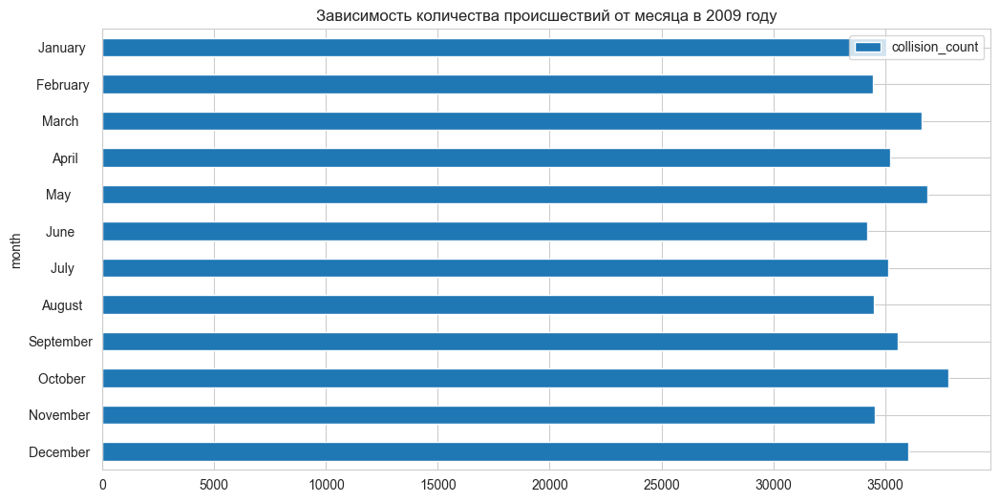

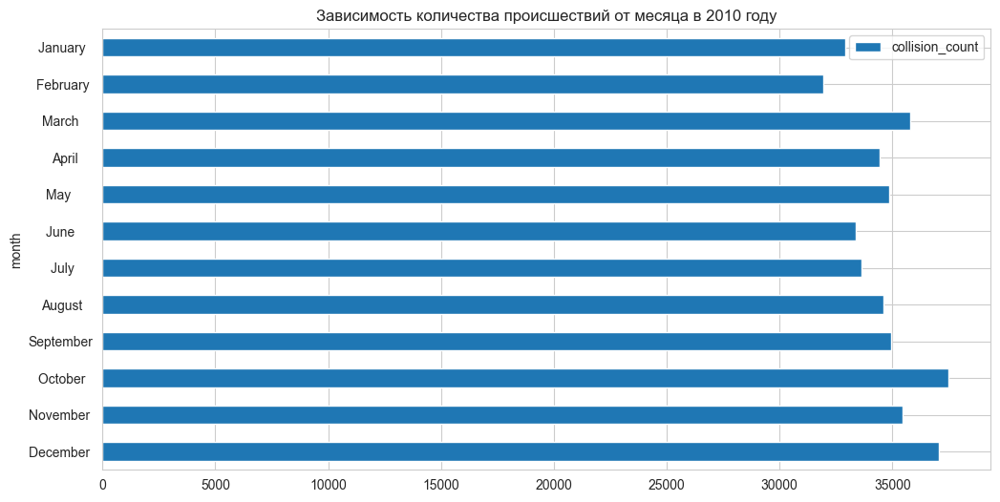

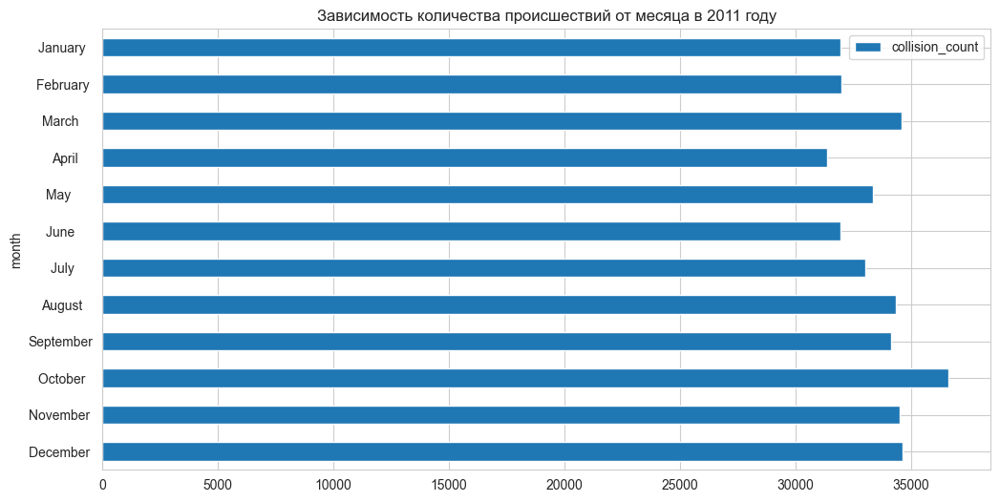

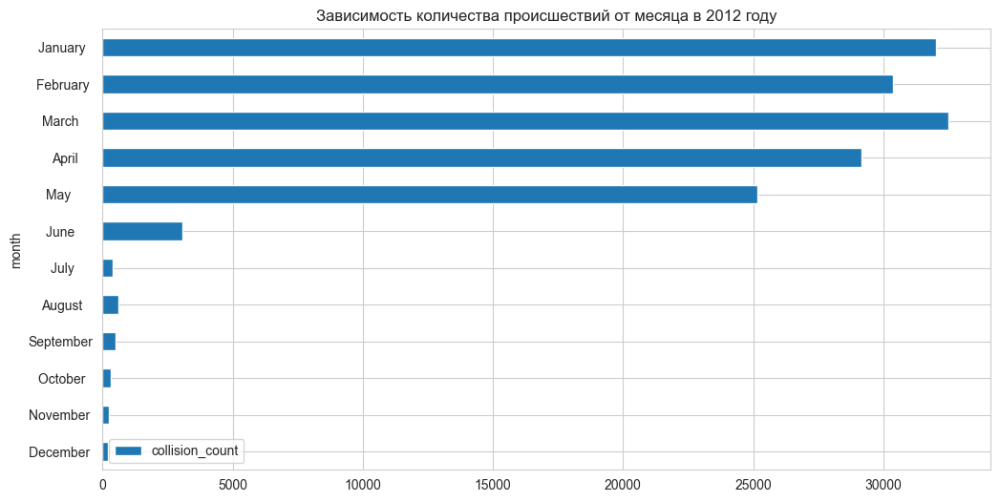

In [23]:
# Построим столбчатую диаграмму зависимости количества происшествий от месяца по годам
for year in (2009, 2010, 2011, 2012):
    show_year_data_per_month(year)

Видно, что данных за 2012 год недостаточно! Поэтому в финальном графике уберем 2012 год из данных.

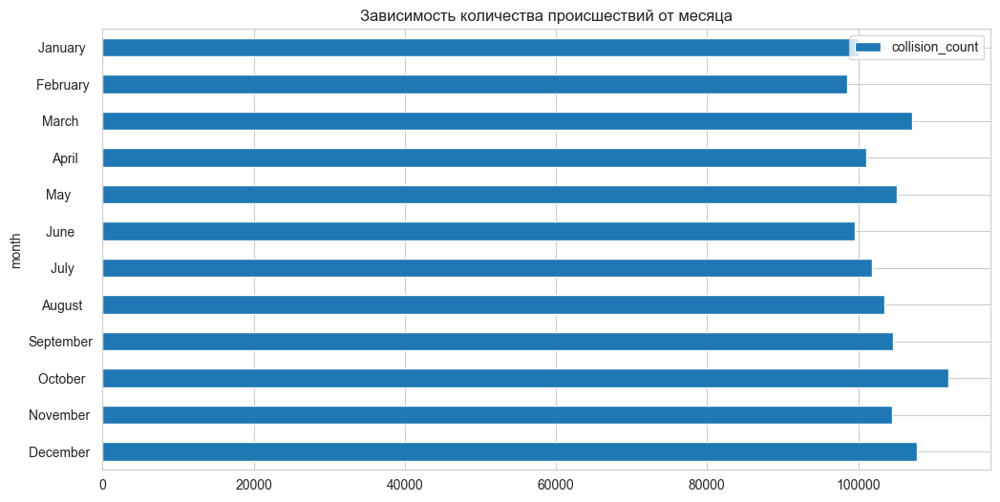

In [24]:
# Построим столбчатую диаграмму зависимости количества происшествий от месяца
sql = f"""
    SELECT TO_CHAR(COLLISION_DATE, 'Month') as month, 
        COUNT(*) as collision_count, 
        EXTRACT(MONTH FROM COLLISION_DATE) AS month_num
    FROM collisions
    WHERE EXTRACT(YEAR FROM collision_date) != 2012
    GROUP BY TO_CHAR(COLLISION_DATE, 'Month'), EXTRACT(MONTH FROM COLLISION_DATE)
    ORDER BY month_num DESC -- collision_count
"""
month_check = sql_to_dataframe(sql)
month_check.plot.barh(x='month', y='collision_count', title='Зависимость количества происшествий от месяца', figsize=(12, 6));

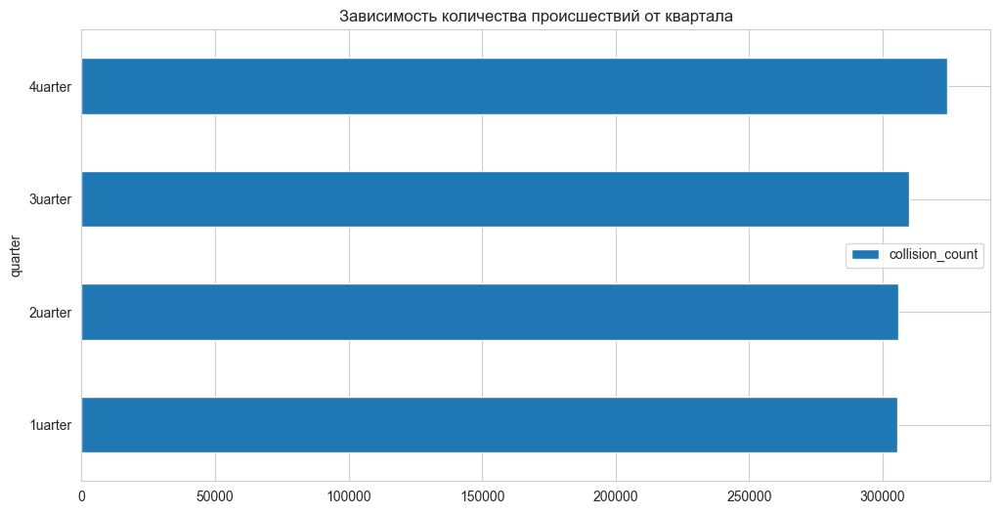

In [25]:
# Построим столбчатую диаграмму зависимости количества происшествий от квартала
sql = f"""
    SELECT TO_CHAR(collision_date, 'Quarter') as quarter, COUNT(*) as collision_count
    FROM collisions
    WHERE EXTRACT(YEAR FROM collision_date) != 2012
    GROUP BY TO_CHAR(collision_date, 'Quarter')
"""
month_check = sql_to_dataframe(sql)
month_check.plot.barh(x='quarter', y='collision_count', title='Зависимость количества происшествий от квартала', figsize=(12, 6));

In [26]:
del check_one
del check_two
del check_three
del check_four
del month_check

Вывод: В данных наблюдается аномалия - не хватает данных за 2012 год. Поэтому для исследования брались только 2009-2011 года.
На графиках видно, что меньше всего аварий происходит летом. А если разбить поквартально - меньше всего аварий в 1 и 2 кварталах года.

### Формулировка задач, выдвижение теорий

#### Задачи для коллег:

- Проведите анализ состояния виновника ДТП, исходя из состояния дороги в момент ДТП (таблицы collisions, parties)
- Проведите анализ серьёзности повреждений транспортного средства, исходя из освещения дороги в момент ДТП (таблица collisions)
- Найдите самые частые причины ДТП (Категории нарушения) у машин с ручной коробкой передач (таблицы collisions, vehicles)
- Найдите самых частых дополнительных участников ДТП, проведите сравнительный анализ (таблица parties)
- Выясните зависимость влияния погодных условий на шанс возникновения ДТП (таблица collisions)
- Выясните связь возраста транспортного средства и количества ДТП (связать collisions и vehicles)
- Выясните насколько чаще нетрезвые водители становятся виновниками ДТП? (связать collisions и parties)
- Найдите влияние типа аварии на общее состояние участника аварии после ДТП. (связать collisions и parties)

#### Порядок решения задачи №1:

- Создайте sql-запрос для каждого состояния дороги;
- Постройте график countplot для каждого состояния дороги;
- Сделайте вывод.

In [33]:
# Предобработаем некоторые колонки
collisions['road_condition_1'].fillna('unknown', inplace=True)
collisions['collision_damage'].fillna('unknown', inplace=True)
parties['party_drug_physical'].fillna('G', inplace=True)

collisions['collision_date'] = pd.to_datetime(collisions['collision_date'], format='%Y-%m-%d')
collisions['case_id'] = collisions['case_id'].astype('int')
parties['case_id'] = parties['case_id'].astype('int')
vehicles['case_id'] = vehicles['case_id'].astype('int')

In [ ]:
# Через sql-запрос
# sql = f"""
#     SELECT *
#     FROM collisions as col, parties as pt
#     WHERE col.case_id = pt.case_id
#         AND pt.at_fault = 1
#         AND pt.party_drug_physical != 'G'
#         AND pt.party_type = 'car'
# """
# for road_condition, data in sql_to_dataframe(sql).groupby('road_condition_1'):
#     sns.countplot(x='road_condition_1', hue='party_drug_physical', data=data.sort_values(['party_drug_physical']))
#     plt.show()

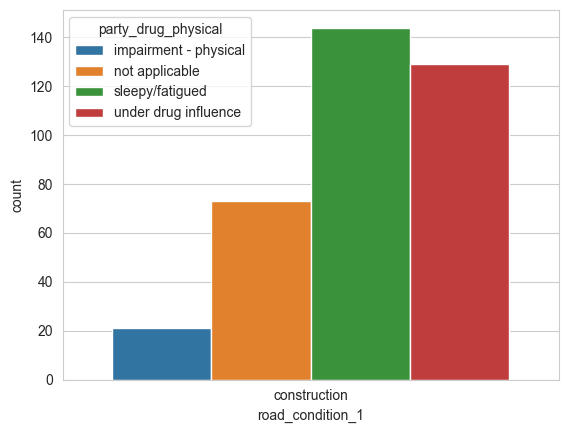

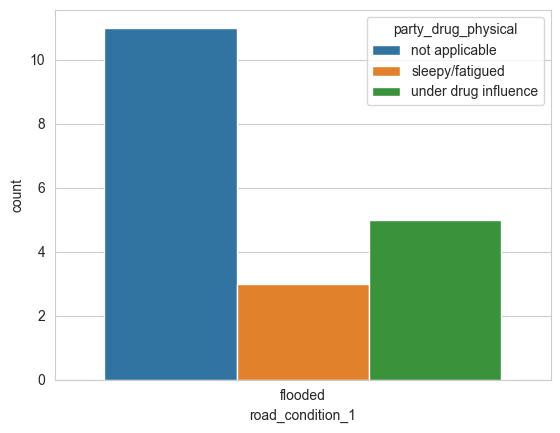

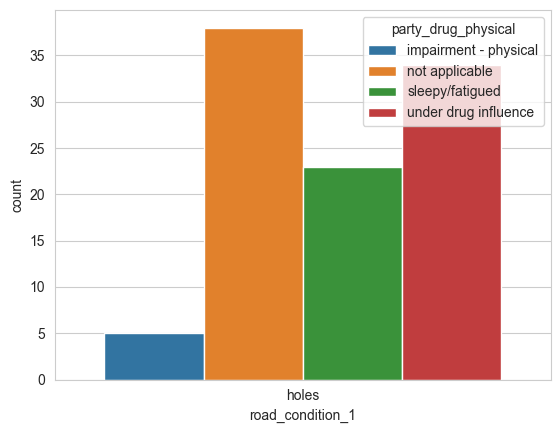

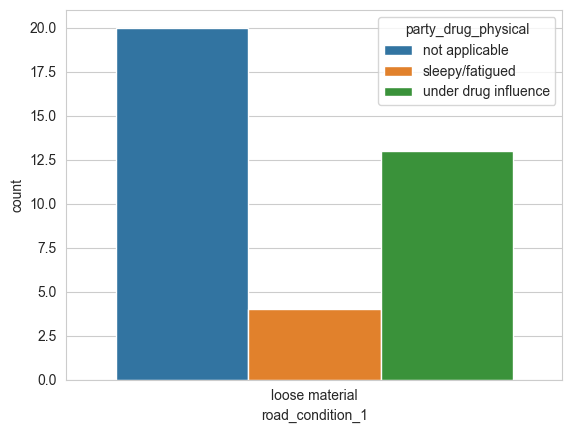

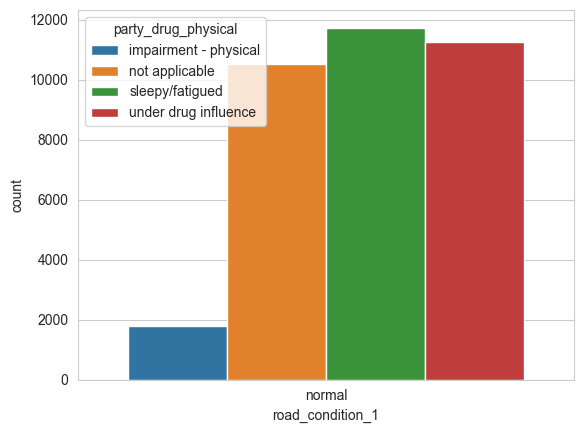

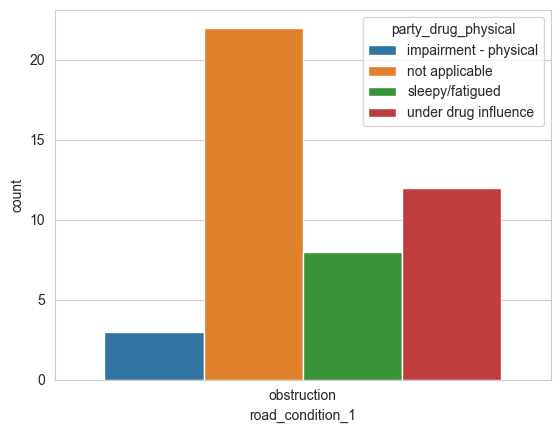

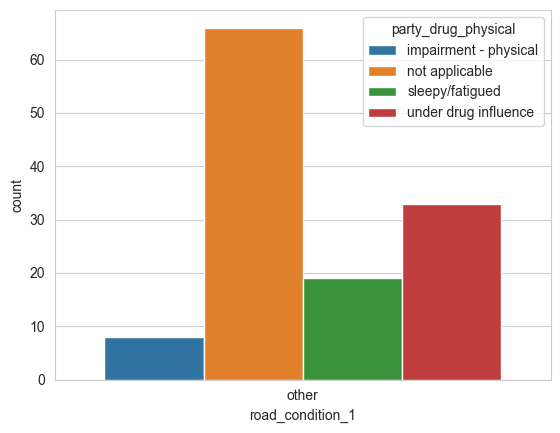

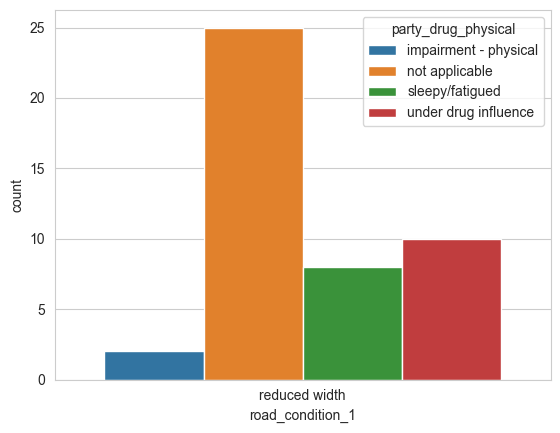

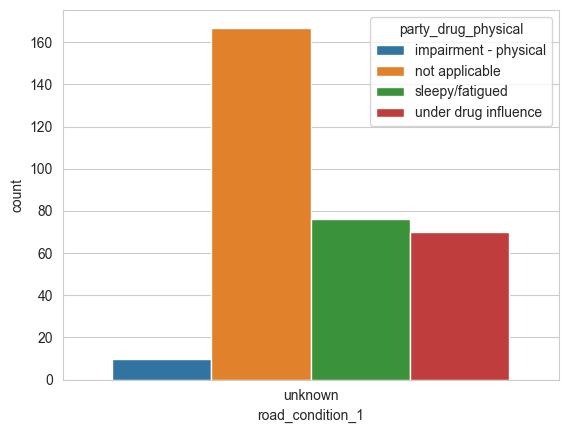

In [37]:
temp = parties.query('at_fault==1 and party_drug_physical != "G" and party_type=="car"')
for road_condition, data in collisions.merge(temp, on='case_id').groupby('road_condition_1'):
    sns.countplot(x='road_condition_1', hue='party_drug_physical', data=data.sort_values(['party_drug_physical']))
    plt.show()
del temp

Вывод: При нормальном дорожном поркрытии виновники ДТП в равном соотношении Not Applicable (Не оценивался) / Sleepy/Fatigued (Сонный/Усталый) / Under Drug Influence (Под воздействием лекарств). При затоплении дорожного полотна, ямах, строительстве на проезжей части резко повышается число пострадавших Under Drug Influence (Под воздействием лекарств) относительно остальных. При перекрытиях, малой ширине дорожного покрытия и неизвестном покрытии число аварий с неоценнённым состоянием потерпевшего увеличивается в 2-3 раза относительно других параметров.

#### Порядок решения задачи №3:

Порядок решения задачи №3:
- Сгруппируйте данные по категории нарушения;
- Постройте pie-диаграмму получившегося датасета;
- Выведите топ-10 самых частых причин ДТП;
- Сделайте вывод.

In [38]:
collisions['pcf_violation_category'].fillna('unknown', inplace=True)

In [40]:
# функция для построения пирожка
def print_pie(grouped):
    sizes = grouped
    labels = grouped.index
    # Создаем график
    fig1, ax1 = plt.subplots(figsize=(6, 5))
    fig1.subplots_adjust(0.3,0,1.5,1)
    theme = plt.get_cmap('bwr')
    ax1.set_prop_cycle("color", [theme(1.3 * i / len(sizes)) for i in range(len(sizes))])
    ax1.pie(sizes, startangle=90)
    ax1.axis('equal')
    total = sum(sizes)
    # Добавляем заголовок и метки осей
    plt.legend(
        loc='upper left',
        labels=['%s, %1.1f%%' % (l, (float(s) / total) * 100) for l, s in zip(labels, sizes)],
        prop={'size': 11},
        bbox_to_anchor=(0.0, 1),
        bbox_transform=fig1.transFigure)
    # Отображаем график
    plt.show()

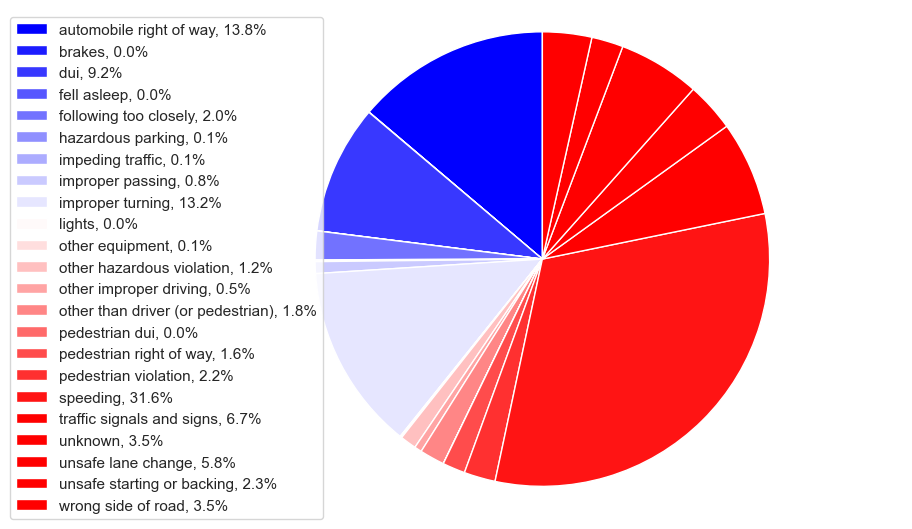

In [44]:
temp = collisions.merge(vehicles.query("vehicle_transmission == 'manual'"), on='case_id')
print_pie(temp.groupby('pcf_violation_category').size())

In [45]:
temp['pcf_violation_category'].value_counts()

speeding                             156322
automobile right of way               68376
improper turning                      65489
dui                                   45511
traffic signals and signs             33286
unsafe lane change                    28753
unknown                               17342
wrong side of road                    17336
unsafe starting or backing            11168
pedestrian violation                  11042
following too closely                 10078
other than driver (or pedestrian)      8789
pedestrian right of way                7962
other hazardous violation              5704
improper passing                       4160
other improper driving                 2580
other equipment                         504
hazardous parking                       342
impeding traffic                        284
lights                                  167
brakes                                  103
fell asleep                              32
pedestrian dui                  

In [46]:
del temp

Вывод: в топ-5 самых частых категорий нарушения при ДТП попали:
- Speeding (Превышение скорости) 31.6%
- Automobile Right of Way (Автомобильное право проезда) 13.8%
- Improper Turning (Неправильный поворот) 13.2%
- Dui (Нарушение водителя) 9.2%
- Traffic Signals and Signs (Дорожные сигналы и знаки) 6.7%

Как видно, практически во всех случаях ДТП (95% от общего количества) происходят по вине водителя по той, или иной причине.
В сумме по вине пешеходов происходит 2.2% ДТП.
По иным причинам 2.1% ДТП(животные, погода и тд.)

## Модель для оценки водительского риска

### Подбор и анализ данных для обучения

Подготовим набор данных на основе первичного предположения заказчика:

Тип виновника — только машина (car).
Возьмем случаи, когда ДТП привело к любым значимым повреждениям автомобиля любого из участников — все, кроме типа SCRATCH (царапина).
Возьмем данные только за 2012 год.
Подготовим исходную таблицу с помощью sql-запроса.

In [47]:
# ТРЕБОВАНИЕ делать все через SQL запрос деструктивно ввиду ограниченности ОЗУ и скорости интернета, так что вот код, если надо.
# sql = f"""
#     WITH collisions_with_car AS (
#         SELECT case_id
#         FROM collisions
#         WHERE case_id IN (SELECT case_id FROM parties WHERE at_fault = 1 AND party_type = 'car')
#             and EXTRACT(YEAR FROM collision_date) = 2012
#             and collision_damage != 'scratch'
#     )
#     SELECT *
#     FROM collisions AS col
#         RIGHT JOIN parties AS pt ON col.case_id = pt.case_id
#         LEFT JOIN vehicles AS vh ON col.case_id = vh.case_id AND vh.party_number = pt.party_number
#     WHERE col.case_id in (select case_id from collisions_with_car)
# """
# temp = sql_to_dataframe(sql)

In [48]:
parties_case_ids = parties.query("at_fault == 1 and party_type == 'car'")['case_id']
collisions_case_ids = collisions.query("collision_damage != 'scratch' and collision_date.dt.year == 2012 and case_id in @parties_case_ids")['case_id']

In [49]:
temp = (collisions.merge(parties, on='case_id', how='right')
        .merge(vehicles, on=['case_id', 'party_number'], how='left')
        .query("case_id in @ collisions_case_ids"))

In [50]:
del parties_case_ids
del collisions_case_ids

In [51]:
describe_dataframe(temp)

,case_id,county_city_location,county_location,distance,direction,intersection,weather_1,location_type,collision_damage,party_count,...,party_type,at_fault,insurance_premium,party_sobriety,party_drug_physical,cellphone_in_use,id_y,vehicle_type,vehicle_transmission,vehicle_age
28645,5488558,3702,san diego,30.0,north,0.0,clear,None,small damage,4,...,road bumper,0,NaN,None,G,NaN,NaN,NaN,NaN,NaN
29071,5488558,3702,san diego,30.0,north,0.0,clear,None,small damage,4,...,road bumper,0,NaN,None,G,NaN,NaN,NaN,NaN,NaN
29409,5488558,3702,san diego,30.0,north,0.0,clear,None,small damage,4,...,road bumper,0,NaN,None,G,NaN,NaN,NaN,NaN,NaN
29740,5490711,4310,santa clara,680.0,south,0.0,clear,None,small damage,3,...,road bumper,0,NaN,None,G,NaN,NaN,NaN,NaN,NaN
30246,5583730,1954,los angeles,30.0,south,0.0,clear,None,small damage,2,...,road bumper,0,NaN,None,G,NaN,NaN,NaN,NaN,NaN


<class 'pandas.core.frame.DataFrame'>
Int64Index: 198481 entries, 28645 to 2752392
Data columns (total 32 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   case_id                      198481 non-null  int32         
 1   county_city_location         198481 non-null  object        
 2   county_location              198481 non-null  object        
 3   distance                     198481 non-null  float64       
 4   direction                    157360 non-null  object        
 5   intersection                 197424 non-null  float64       
 6   weather_1                    197925 non-null  object        
 7   location_type                83178 non-null   object        
 8   collision_damage             198481 non-null  object        
 9   party_count                  198481 non-null  int64         
 10  primary_collision_factor     198481 non-null  object        
 11  pcf_violation_categor

None

,count,mean,std,min,50%,max
case_id,198481.0,5.558710e+06,58107.824033,5064690.0,5556153.0,5668369.0
distance,198481.0,6.433808e+02,8205.820504,0.0,100.0,1584000.0
intersection,197424.0,1.904226e-01,0.392636,0.0,0.0,1.0
party_count,198481.0,2.162308e+00,0.767193,1.0,2.0,12.0
id_x,198481.0,2.589657e+06,97512.833024,1687780.0,2593201.0,2752408.0
party_number,198481.0,1.581179e+00,0.708908,1.0,1.0,12.0
at_fault,198481.0,5.191782e-01,0.499633,0.0,1.0,1.0
insurance_premium,165463.0,3.866128e+01,16.268125,0.0,36.0,105.0
cellphone_in_use,167112.0,2.351118e-02,0.151521,0.0,0.0,1.0
id_y,55616.0,1.429080e+06,54433.517743,985527.0,1431578.5,1517654.0


Количество дублированных строк: 0


Изучим описание факторов. Нужно отобрать те, которые могут влиять на вероятность стать виновником ДТП.

| Название колонки            | Краткое описание   | Влияние на вероятность стать виновником ДТП   | Вердикт  |
|:----------------------------|:-------------------|:----------------------------------------------|:---------|
| id                          | уникальный номер   | не влияет                                     | удалить  |
| case_id                     | номер случая       | не влияет                                     | удалить  |
| party_number                | номер участника    | не влияет                                     | удалить  |
| party_type                  | тип участника      | точно влияет                                  | оставить |
| at_fault                    | виновность         | целевой признак                               | оставить |
| insurance_premium           | страховая премия   | не можем знать заранее                        | удалить  |
| party_sobriety              | трезвость          | очевидно влияет                               | оставить |
| party_drug_physical         | состояние участ.   | не можем знать заранее                        | удалить  |
| cellphone_in_use            | разговор по тел.   | будет ли водитель говорить по тел.? не знаем  | удалить  |
| vehicle_type                | тип кузова         | тип кузова известен заранее, но не влияет     | удалить  |
| vehicle_transmission        | тип трансмиссии    | не влияет                                     | удалить  |
| vehicle_age                 | возраст авто       | точно влияет                                  | оставить |
| county_location             | регион             | прямая корреляция с другими факторам, удалить | удалить  |
| distance                    | расстояние до ц.д. | не можем знать заранее                        | удалить  |
| direction                   | направление        | север страшнее юга, происки запада? нет       | удалить  |
| intersection                | перекрёсток ли     | точно влияет                                  | оставить |
| weather_1                   | погода             | точно влияет                                  | оставить |
| location_type               | тип дороги         | точно влияет                                  | оставить |
| collision_damage            | урон               | не можем знать заранее                        | удалить  |
| party_count                 | количество уч.     | не можем знать заранее                        | удалить  |
| primary_collision_factor    | гл. фактор ДТП     | не можем знать заранее                        | удалить  |
| pcf_violation_category      | кат. нарушения     | не можем знать заранее                        | удалить  |
| type_of_collision           | тип столкновения   | не можем знать заранее                        | удалить  |
| motor_vehicle_involved_with | тип участников     | не можем знать заранее                        | удалить  |
| road_surface                | тип покрытия       | точно влияет                                  | оставить |
| road_condition_1            | состояние дороги   | точно влияет                                  | оставить |
| lighting                    | освещённость       | точно влияет                                  | оставить |
| control_device              | устройство слеж.   | никак не помогает при вождении                | удалить  |
| collision_date              | дата ДТП           | не можем знать заранее                        | удалить  |
| collision_time              | время ДТП          | не можем знать заранее                        | удалить  |

Почистим данные.

In [52]:
model_columms =[
    'party_type',
    'party_sobriety',
    'intersection',
    'weather_1',
    'road_surface',
    'lighting',
    'location_type',
    'road_condition_1',
    'vehicle_age',
    'at_fault'
]
# Оценка риска ДТП по маршруту движения

In [53]:
model_query = temp[model_columms]
target = model_query[['at_fault']]
describe_dataframe(model_query)

,party_type,party_sobriety,intersection,weather_1,road_surface,lighting,location_type,road_condition_1,vehicle_age,at_fault
28645,road bumper,None,0.0,clear,dry,dark with street lights,None,normal,NaN,0
29071,road bumper,None,0.0,clear,dry,dark with street lights,None,normal,NaN,0
29409,road bumper,None,0.0,clear,dry,dark with street lights,None,normal,NaN,0
29740,road bumper,None,0.0,clear,dry,daylight,None,normal,NaN,0
30246,road bumper,None,0.0,clear,dry,dusk or dawn,None,normal,NaN,0


<class 'pandas.core.frame.DataFrame'>
Int64Index: 198481 entries, 28645 to 2752392
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   party_type        198387 non-null  object 
 1   party_sobriety    193277 non-null  object 
 2   intersection      197424 non-null  float64
 3   weather_1         197925 non-null  object 
 4   road_surface      197279 non-null  object 
 5   lighting          197846 non-null  object 
 6   location_type     83178 non-null   object 
 7   road_condition_1  198481 non-null  object 
 8   vehicle_age       54027 non-null   float64
 9   at_fault          198481 non-null  int64  
dtypes: float64(2), int64(1), object(7)
memory usage: 16.7+ MB


None

,count,mean,std,min,50%,max
intersection,197424.0,0.190423,0.392636,0.0,0.0,1.0
vehicle_age,54027.0,4.874156,3.237480,0.0,4.0,161.0
at_fault,198481.0,0.519178,0.499633,0.0,1.0,1.0


Количество дублированных строк: 188316


In [54]:
del temp

Видно, что есть множество отсутствующих значений, заменим их на "unknown". Каждая авария должна быть учтена!

In [55]:
object_columns = filter(lambda column: is_string_dtype(model_query[column]), model_query.columns)
for column in object_columns:
    model_query[column].fillna('unknown', inplace=True)

In [56]:
# Переведем колонки intersection и at_fault к более корректному типу
model_query['intersection'] = np.floor(pd.to_numeric(model_query['intersection'], errors='coerce')).astype('Int32')
model_query['at_fault'] = np.floor(pd.to_numeric(model_query['at_fault'], errors='coerce')).astype('Int32')

Колонку intersection дополним нулями - их большинство (81%)

In [57]:
model_query['intersection'].fillna(0, inplace=True)
model_query.loc[model_query['vehicle_age'] > 40, 'vehicle_age'] = 40
model_query['vehicle_age'].fillna(round(model_query['vehicle_age'].mean()), inplace=True);

In [58]:
display(model_query.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 198481 entries, 28645 to 2752392
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   party_type        198481 non-null  object 
 1   party_sobriety    198481 non-null  object 
 2   intersection      198481 non-null  Int32  
 3   weather_1         198481 non-null  object 
 4   road_surface      198481 non-null  object 
 5   lighting          198481 non-null  object 
 6   location_type     198481 non-null  object 
 7   road_condition_1  198481 non-null  object 
 8   vehicle_age       198481 non-null  float64
 9   at_fault          198481 non-null  Int32  
dtypes: Int32(2), float64(1), object(7)
memory usage: 15.5+ MB


None

In [60]:
# Построим матрицу корреляции
def correlation_matrix(model_query):
    phik_overview = model_query.phik_matrix(interval_cols=[])
    phik_overview.round(2)

    plot_correlation_matrix(
        phik_overview.values,
        x_labels=phik_overview.columns,
        y_labels=phik_overview.index,
        vmin=0,
        vmax=1
    );

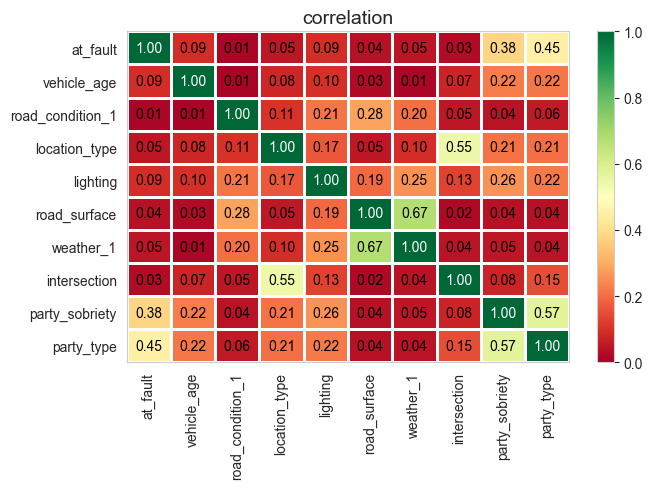

In [61]:
correlation_matrix(model_query)

Вывод: Интересная ситуация. Мы выбрали все критерии, которые можно узнать до поездки, кроме местности и даты. О, как оказалось, что 2 единственных реально значащих критерия - уровень трезвости виновника и тип участника происшествия.

### Детальный анализ выбранных параметров для модели обучения

In [62]:
# функция для построения столбчатой диаграммы
def bar_plot(df, x, height=5, title=None):
    if title is None:
        title = f'График по столбцу {x}'
    # Добавляем заголовок
    plt.title(title)
    # Отображаем график
    plt.bar(df[x], height)

# функция для построения гистограммы
def gist_plot(df, x, bins=20, title=None):
    if title is None:
        title = f'График по столбцу {x}'
    # Создаем график
    plt.figure(figsize=(14, 8)) # Задаем размер графика
    # Строим график с помощью функции plot
    plt.hist(df[x], bins=bins)
    # Добавляем заголовок и метки осей
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel('stars count')
    # Отображаем график
    plt.show()

In [63]:
# Определение функций для отображения распределения категорий
def display_objects(dataframe):
    object_columns = filter(lambda column: is_string_dtype(dataframe[column]), dataframe.columns)
    for i, column in enumerate(object_columns, 1):
        display(f"{i} Категориальная колонка: {column}")
        display(dataframe[column].value_counts())
        print_pie(dataframe.groupby(column).size())

# Определение функций для отображения распределения бинарных параметров
def display_digits(dataframe):
    digit_columns = filter(lambda column: not is_string_dtype(dataframe[column]), dataframe.columns)
    for i, column in enumerate(digit_columns, 1):
        display(f"{i} Численная колонка: {column}")
        display(dataframe[column].value_counts())
        gist_plot(dataframe, column)

'1 Категориальная колонка: party_type'

car            180689
road bumper     14460
road signs       1714
building         1029
other             495
unknown            94
Name: party_type, dtype: int64

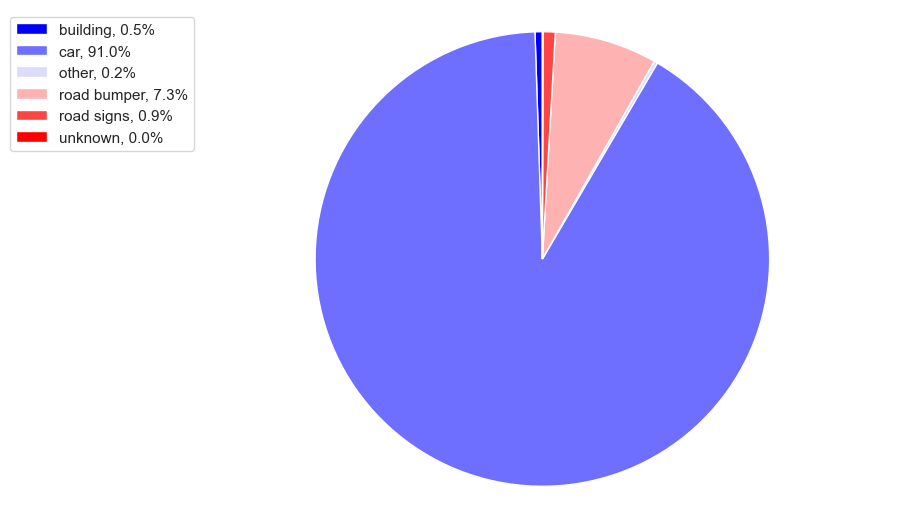

'2 Категориальная колонка: party_sobriety'

had not been drinking                     148138
impairment unknown                         18713
not applicable                             13458
had been drinking, under influence         10139
unknown                                     5204
had been drinking, impairment unknown       1550
had been drinking, not under influence      1279
Name: party_sobriety, dtype: int64

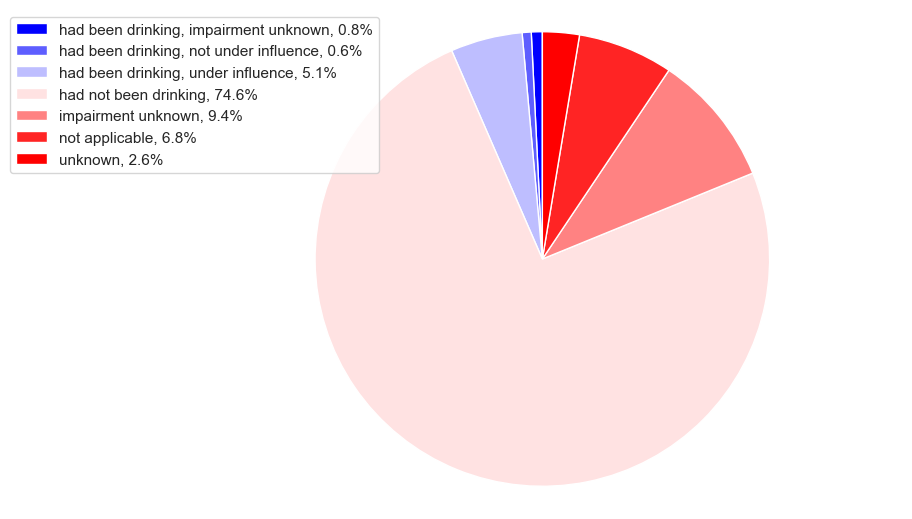

'3 Категориальная колонка: weather_1'

clear      158783
cloudy      29633
raining      8267
fog           603
unknown       556
snowing       440
other         164
wind           35
Name: weather_1, dtype: int64

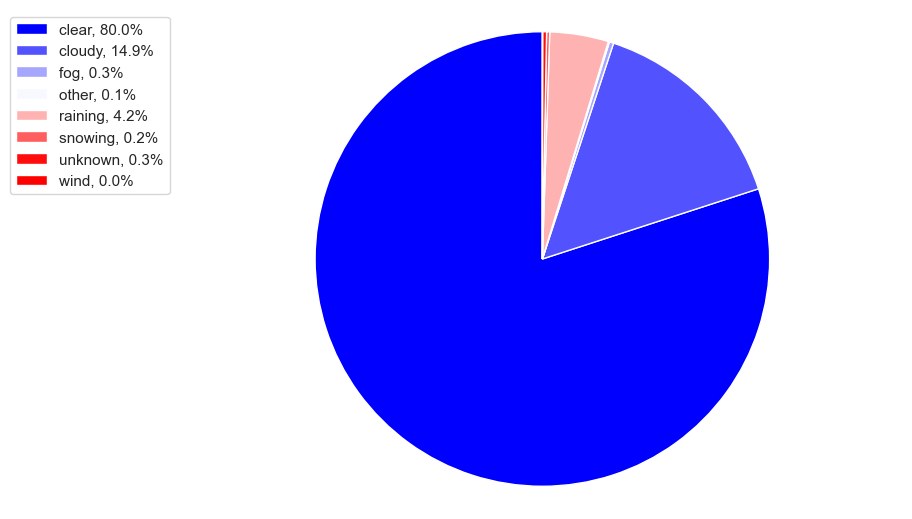

'4 Категориальная колонка: road_surface'

dry         177029
wet          19176
unknown       1202
snowy          937
slippery       137
Name: road_surface, dtype: int64

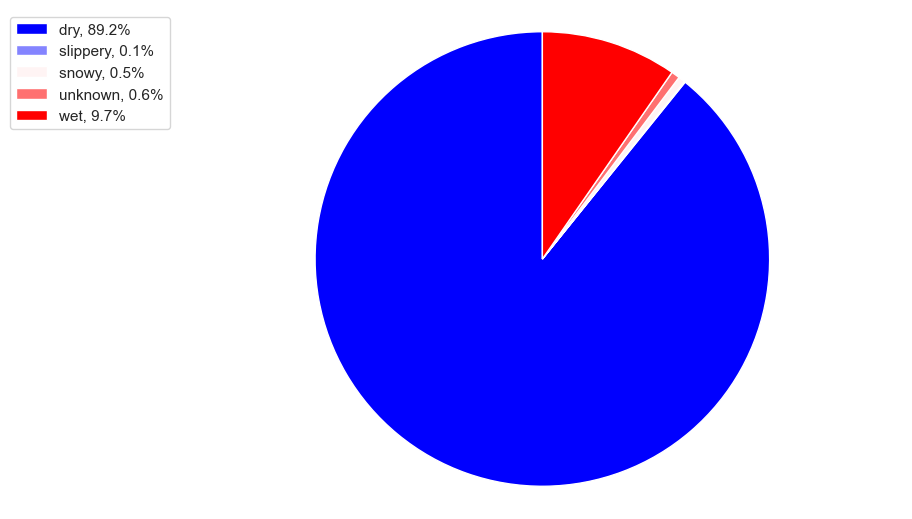

'5 Категориальная колонка: lighting'

daylight                                   134103
dark with street lights                     42292
dark with no street lights                  14232
dusk or dawn                                 6775
unknown                                       635
dark with street lights not functioning       444
Name: lighting, dtype: int64

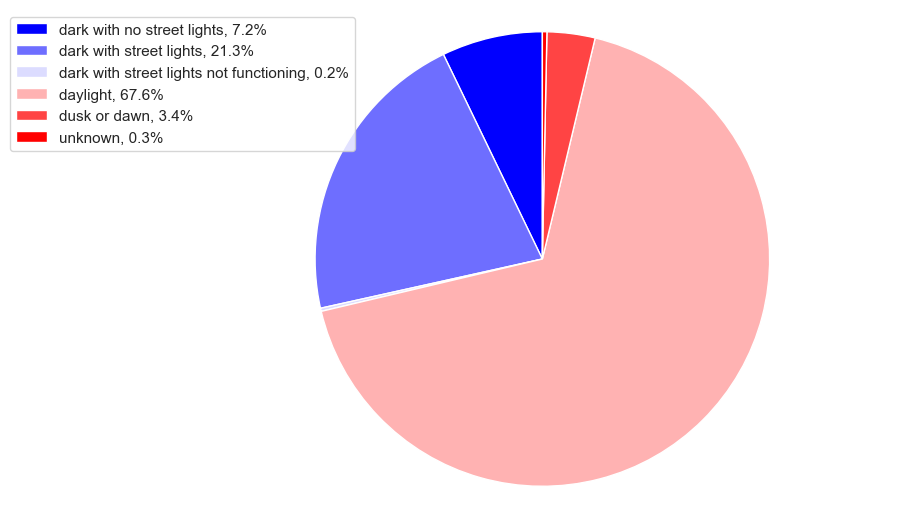

'6 Категориальная колонка: location_type'

unknown         115303
highway          68547
ramp             10906
intersection      3725
Name: location_type, dtype: int64

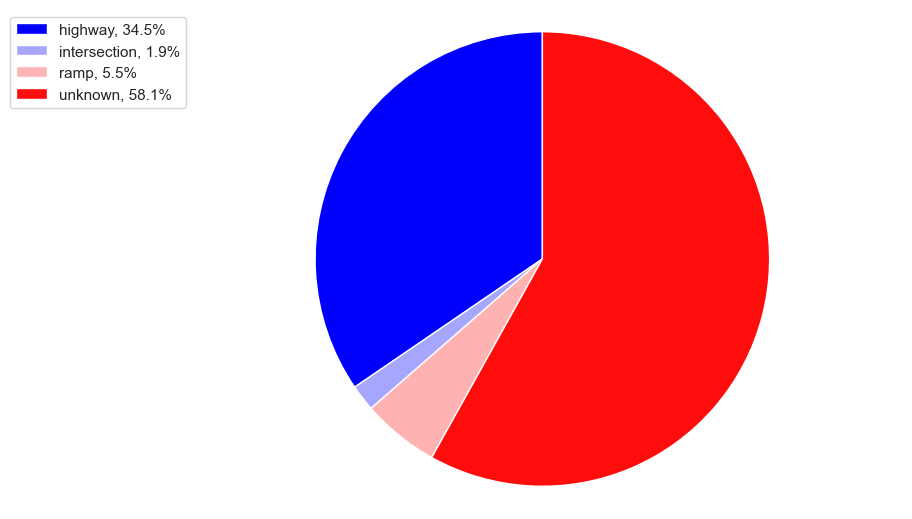

'7 Категориальная колонка: road_condition_1'

normal            191648
construction        3215
unknown             1036
other                751
obstruction          636
holes                589
loose material       277
reduced width        223
flooded              106
Name: road_condition_1, dtype: int64

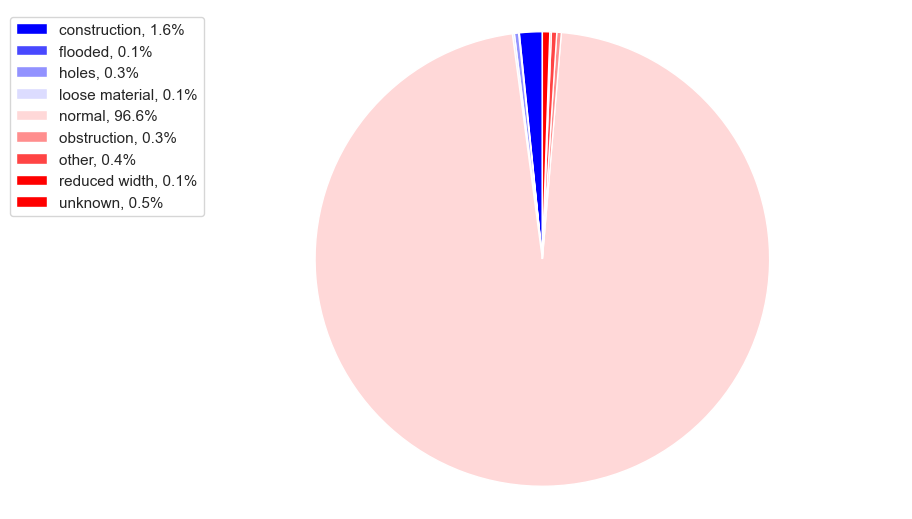

'1 Численная колонка: intersection'

0    160887
1     37594
Name: intersection, dtype: Int64

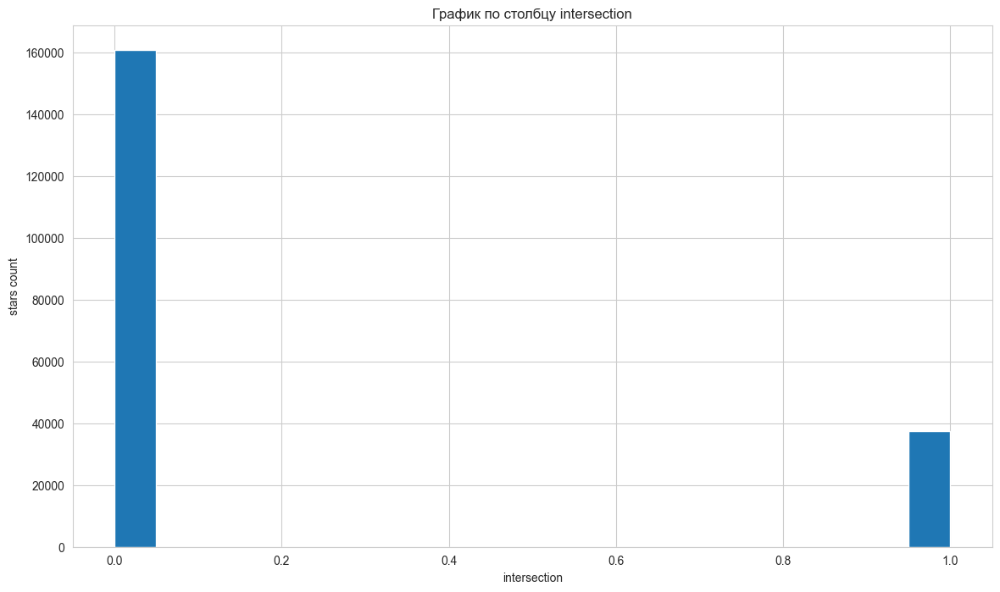

'2 Численная колонка: vehicle_age'

5.0     149915
3.0      10883
4.0       7077
2.0       6082
6.0       3927
7.0       3826
8.0       3500
0.0       2988
9.0       2779
1.0       2440
10.0      1945
11.0      1360
12.0       863
13.0       558
14.0       284
15.0        41
16.0         7
17.0         3
40.0         2
19.0         1
Name: vehicle_age, dtype: int64

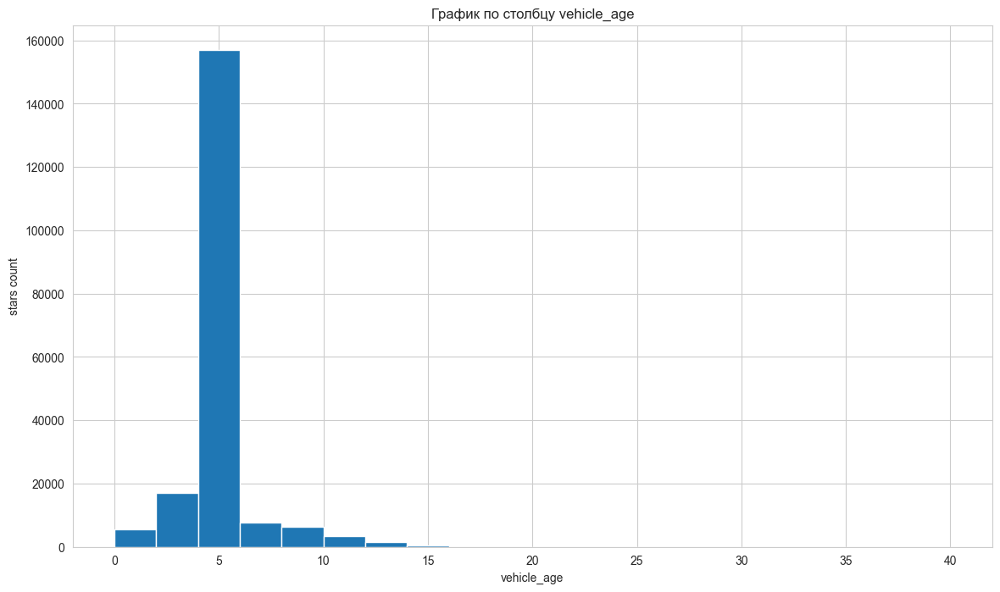

'3 Численная колонка: at_fault'

1    103047
0     95434
Name: at_fault, dtype: Int64

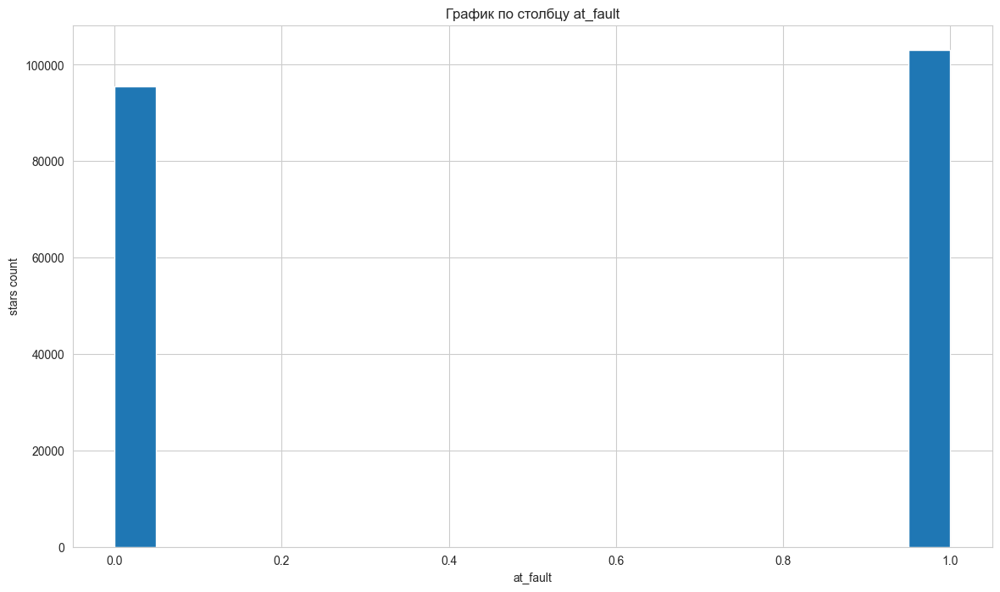

In [64]:
display_objects(model_query)
display_digits(model_query)

In [65]:
model_query.drop('location_type', axis=1, inplace=True)

Вывод:
- 'paty_type' в этой колонке в основном автомобили, а на втором месте объекты проезжей части, в сумме они дают 98% участиков ДТП.
- 'party_sobriety' 85% участников ДТП были трезвы или их состояние не установлено, надо будет разобраться как эти данные повлиюят на модель.
- 'intersection' большинство мест ДТП не перекрестки.
- 'weather_1'в 95% погода - или ясная, или немного облачно.
- 'road_surface' состояние дороги всегда - или сухая, или влажная.
- 'lighting' в данном случае освещение не всегда хорошее, поэтому может сильно влиять на показания модели.
- 'location_type' - почти 60% неизвестно, поэтому исключим данную колонку из исследования.
- 'road_condition_1' - дорога или обычная или иду дорожные работы. Может влиять на поведение модели. Однако 98% данных одинаковы.
- 'vehicle_age' - большинство данных неизвестно, поэтому заполнили средним значением - 5 лет, данную колонку точно стоит учесть.
- 'at_fault' - таргет смещен всего на 2%, но все же проведем масштабирование - лишним не будет.

### Подготовка данных для обучения

In [66]:
# Подготовка данных для моделей
train = model_query.drop('at_fault', axis=1)
target = model_query['at_fault']
train[:10]

,party_type,party_sobriety,intersection,weather_1,road_surface,lighting,road_condition_1,vehicle_age
28645,road bumper,unknown,0,clear,dry,dark with street lights,normal,5.0
29071,road bumper,unknown,0,clear,dry,dark with street lights,normal,5.0
29409,road bumper,unknown,0,clear,dry,dark with street lights,normal,5.0
29740,road bumper,unknown,0,clear,dry,daylight,normal,5.0
30246,road bumper,unknown,0,clear,dry,dusk or dawn,normal,5.0
30497,road bumper,unknown,0,clear,dry,daylight,normal,5.0
30580,road bumper,unknown,0,clear,dry,dark with street lights,normal,5.0
30663,road bumper,unknown,0,clear,dry,daylight,normal,5.0
30830,road bumper,unknown,0,clear,dry,daylight,normal,5.0
31080,road bumper,unknown,0,clear,dry,dusk or dawn,normal,5.0


In [67]:
categorial_columns =[
    'party_type',     # Тип участника происшествия. Таблица parties
    'party_sobriety', # Уровень трезвости виновника (точно может влиять). Таблица parties
    'intersection', # Является ли место происшествия перекрестком - много аварий происходит на перекрестках, особенно при левом повороте. Таблица collisions
    'weather_1', # Погода. Погодные условия явно влияют на аварийную ситуацию Таблица. collisions
    'road_surface', # Состояние дороги. Попадали ли вы в яму на скорости? Таблица. collisions
    'lighting', # Освещение влияет только в тёмное время суток и в тоннеле Таблица. collisions
    # 'location_type', # Тип дороги. Удалено, т.к. в этой колонке 60% неизвестных значений.
    'road_condition_1', # Дорожное состояние, препятствие на дороге - плохо. Таблица collisions
]

In [68]:
X_train, X_test, y_train, y_test = train_test_split(train, target, random_state=RANDOM_STATE)

In [69]:
# Создадим Encoder
encoder = OneHotEncoder(handle_unknown='ignore', drop='first')

In [70]:
# Обучим Encoder на трейне
encoder.fit(X_train[categorial_columns])

OneHotEncoder(drop='first', handle_unknown='ignore')

In [71]:
X_train_encoded = pd.DataFrame(
    encoder.transform(X_train[categorial_columns]).toarray(),
    columns=encoder.get_feature_names_out(categorial_columns),
    index=X_train.index
)
# X_train_encoded = pd.concat((X_train[numeric_columns], X_train_encoded), axis=1)

In [72]:
X_test_encoded = pd.DataFrame(
    encoder.transform(X_test[categorial_columns]).toarray(),
    columns=encoder.get_feature_names_out(categorial_columns),
    index=X_test.index
)
# X_test_encoded = pd.concat((X_test[numeric_columns], X_test_encoded), axis=1)

In [73]:
X_train_encoded

,party_type_car,party_type_other,party_type_road bumper,party_type_road signs,party_type_unknown,"party_sobriety_had been drinking, not under influence","party_sobriety_had been drinking, under influence",party_sobriety_had not been drinking,party_sobriety_impairment unknown,party_sobriety_not applicable,...,lighting_dusk or dawn,lighting_unknown,road_condition_1_flooded,road_condition_1_holes,road_condition_1_loose material,road_condition_1_normal,road_condition_1_obstruction,road_condition_1_other,road_condition_1_reduced width,road_condition_1_unknown
538758,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
461052,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
534077,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
363587,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
424108,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
587879,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
409461,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
593055,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
337654,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [74]:
# Не будем скейлить данные, т.к. они уже все в диапазоне от 0 до 1
X_train_scaled = X_train_encoded
X_test_scaled = X_test_encoded
kf = KFold(n_splits=3, random_state=RANDOM_STATE, shuffle=True)

In [75]:
del X_train_encoded
del X_test_encoded

In [76]:
# Создадим DataFrame для записи результатов предсказаний моделей
results = {}

In [77]:
def roc_graph(tv, pv):
    fpr, tpr, thresholds = roc_curve(tv, pv)
    roc_auc = auc(fpr, tpr)
    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.grid()
    plt.show()

0.5200016122206323

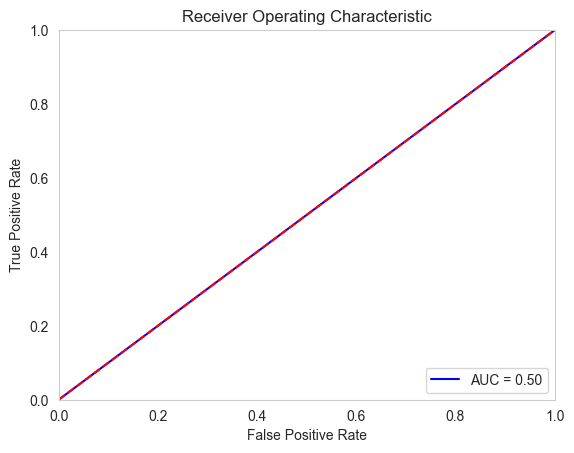

In [78]:
# Посмотрим результат фейковой модели из одних единиц
dummies = pd.Series(1, index=y_test.index)
display(accuracy_score(y_test, dummies))
roc_graph(y_test, pd.Series(1, index=y_test.index))

In [79]:
results['Dummy Classifier (most frequent)'] = classification_report(
    y_test, dummies,
    output_dict=True, zero_division=0
)['weighted avg']

Вывод: фейковая модель, как и водится показывает смещение таргета. В данных ровно 52% единиц, поэтому точность 52%.
Следовательно, в последующих моделях потребуется добиться точности выше 53%, а лучше раза в полтора.
Для определения качества моделей воспользуемся совокупностью точности accuracy и полнотой нулей и единиц ROC_AUC.
Параметры модели определим подбором (кроме нейросети), а не будем брать из головы.

### Базовая модель логистической регрессии

In [80]:
params = {
    'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky'],
    'random_state': [RANDOM_STATE],
    'max_iter': [350]
}
params = {'logisticregression__' + key: params[key] for key in params}
dt_pipeline = make_pipeline(
    SMOTE(random_state=RANDOM_STATE),
    LogisticRegression()
)

In [81]:
grid_lr = GridSearchCV(dt_pipeline, param_grid=params, cv=kf, scoring='roc_auc',
                       return_train_score=True)

In [82]:
grid_lr.fit(X_train_scaled, y_train)
lr_preds = grid_lr.predict_proba(X_test_scaled)[:, 1]
f'roc_auc базовой модели: {grid_lr.best_score_}'

'roc_auc базовой модели: 0.7205816090263286'

In [101]:
results['Logistic Regression'] = classification_report(
    y_test, np.round(lr_preds),
    output_dict=True, zero_division=0
)['weighted avg']

In [ ]:
f"Средняя оценка roc_auc лучшей lr модели: {grid_lr.best_score_}, Параметры: {grid_lr.best_params_}"

0.638701356280607

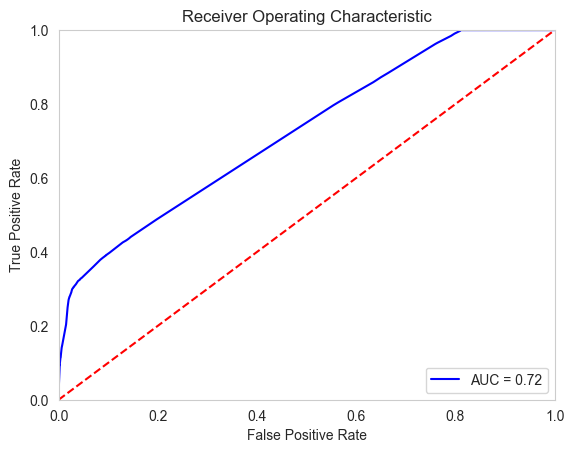

In [120]:
# Результат предсказаний лучшей lr модели
display(accuracy_score(y_test, np.round(lr_preds)))
roc_graph(y_test, lr_preds)

### Модель случайного леса

In [103]:
params = {
    'criterion': ['gini', 'entropy'],
    'max_depth': range(6, 16, 2),
    'random_state': [RANDOM_STATE]
}
params = {'decisiontreeclassifier__' + key: params[key] for key in params}
dt_pipeline = make_pipeline(
    SMOTE(random_state=RANDOM_STATE),
    DecisionTreeClassifier()
)

In [104]:
grid_dt = RandomizedSearchCV(dt_pipeline, param_distributions=params, cv=kf, scoring='roc_auc', return_train_score=True)

In [105]:
grid_dt.fit(X_train_scaled, y_train)
dt_preds = grid_dt.predict_proba(X_test_scaled)[:, 1]
grid_dt.best_params_

{'decisiontreeclassifier__random_state': 12321,
 'decisiontreeclassifier__max_depth': 10,
 'decisiontreeclassifier__criterion': 'entropy'}

In [121]:
results['Decision Tree Classifier'] = classification_report(
    y_test, np.round(dt_preds),
    output_dict=True, zero_division=0
)['weighted avg']

In [122]:
f"Средняя оценка лучшей dt модели: {grid_dt.best_score_}, Глубина дерева: {grid_dt.best_params_['decisiontreeclassifier__max_depth']}, Лучший критерий: {grid_dt.best_params_['decisiontreeclassifier__criterion']}"

'Средняя оценка лучшей dt модели: 0.7193673221767444, Глубина дерева: 10, Лучший критерий: entropy'

0.6365450111847807

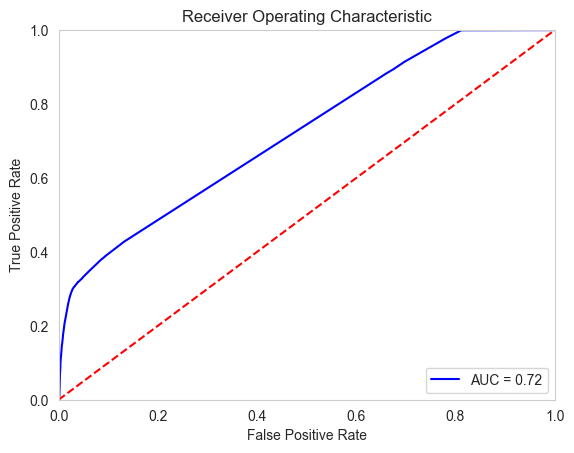

In [123]:
# Результат предсказаний лучшей lr модели
display(accuracy_score(y_test, np.round(dt_preds)))
roc_graph(y_test, dt_preds)

### Модель Catboost

In [124]:
%%time

params = {
    'loss_function':'Logloss', # objective function
    'eval_metric':'AUC', # metric
    'verbose': 200, # output to stdout info about training process every 200 iterations
    'random_seed': RANDOM_STATE}
cbc_1 = CatBoostClassifier(**params)
cbc_1.fit(
    X_train_scaled, y_train, # data to train on (required parameters, unless we provide X as a pool object, will be shown below)
    eval_set=(X_test_scaled, y_test), # data to validate on
    use_best_model=True, # True if we don't want to save trees created after iteration with the best validation score
    plot=True # True for visualization of the training process (it is not shown in a published kernel - try executing this code)
);

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.10904
0:	test: 0.7132942	best: 0.7132942 (0)	total: 211ms	remaining: 3m 30s
200:	test: 0.7232600	best: 0.7241959 (61)	total: 14.5s	remaining: 57.6s
400:	test: 0.7227182	best: 0.7241959 (61)	total: 19.1s	remaining: 28.6s
600:	test: 0.7223924	best: 0.7241959 (61)	total: 22.8s	remaining: 15.2s
800:	test: 0.7222118	best: 0.7241959 (61)	total: 27.3s	remaining: 6.79s
999:	test: 0.7218874	best: 0.7241959 (61)	total: 31.2s	remaining: 0us

bestTest = 0.7241958818
bestIteration = 61

Shrink model to first 62 iterations.
CPU times: total: 53.9 s
Wall time: 33.7 s


0.6396082303863284

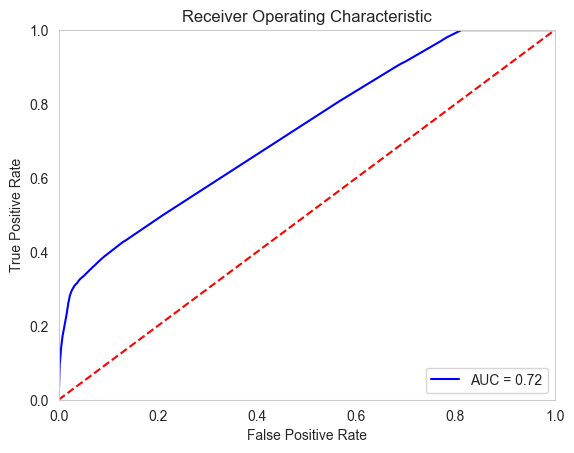

In [125]:
cbc_1_preds = cbc_1.predict_proba(X_test_scaled)[:, 1]
display(accuracy_score(y_test, np.round(cbc_1_preds)))
roc_graph(y_test, cbc_1_preds)

In [126]:
results['Cat Boost Classifier'] = classification_report(
    y_test, np.round(cbc_1_preds),
    output_dict=True, zero_division=0
)['weighted avg']

### Модель нейронной сети

In [127]:
# Перевод данных для обучения и тестирования модели в тензоры
X_train_tensor = torch.FloatTensor(np.array(X_train_scaled))
X_test_tensor = torch.FloatTensor(np.array(X_test_scaled))

In [128]:
y_train_tensor = torch.FloatTensor(np.array(y_train.astype('int64')))
y_test_tensor = torch.FloatTensor(np.array(y_test.astype('int64')))

In [129]:
display(X_train_tensor.shape)
display(y_train_tensor.shape)
display(X_test_tensor.shape)
display(y_test_tensor.shape)

torch.Size([148860, 36])

torch.Size([148860])

torch.Size([49621, 36])

torch.Size([49621])

In [130]:
# установка константных состояний
random.seed(RANDOM_STATE)
np.random.seed(RANDOM_STATE)
torch.manual_seed(RANDOM_STATE)
torch.use_deterministic_algorithms(True)

# количество слоев и нейронов
input_size = X_train_tensor.shape[1]
hidden_size_1 =  27
hidden_size_2 =  17
hidden_size_3 =  8
out_size = 1
# количество эпох
num_epochs = 1000
# скорость обучения
learn = 0.18

In [131]:
class CustomEarlyStopping():
    """
    Ранняя остановка, чтобы остановить тренировку, когда потеря не улучшается после определенной эпохи.
    """
    def __init__(self, patience=5, min_delta=0):
        """
        :param patience: сколько эпох ждать, прежде чем остановиться, когда потеря не улучшается
        :param min_delta: минимальная разница между loss/метриками, если улучшений нет, то остановим обучение
        """
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss == None:
            self.best_loss = val_loss
        elif self.best_loss - val_loss > self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        elif self.best_loss - val_loss < self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                print('INFO: Early stopping')
                self.early_stop = True

In [132]:
# класс нейронной сети
class NeuralNet(nn.Module):
    def __init__(self, input_size, hidden_size_1, hidden_size_2, hidden_size_3, out_size, optimizer=None, loss=None):
        super(NeuralNet, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size_1)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size_1, hidden_size_2)
        self.relu2 = nn.Softplus()
        self.fc3 = nn.Linear(hidden_size_2, hidden_size_3)
        self.relu3 = nn.LogSigmoid()
        self.fc4 = nn.Linear(hidden_size_3, out_size)
        self.relu4 = nn.Sigmoid()
        if optimizer is None:
            self.optimizer = torch.optim.Adam(self.parameters(), lr=learn)
        else:
            self.optimizer = optimizer
        if loss is None:
            self.loss = nn.functional.binary_cross_entropy_with_logits
        else:
            self.loss = loss

    def forward(self, x):
        out = self.fc1(x)
        out = self.relu1(out)
        out = self.fc2(out)
        out = self.relu2(out)
        out = self.fc3(out)
        out = self.relu3(out)
        out = self.fc4(out)
        out = self.relu4(out)
        return out

    def train_epoch(self, x, y):
        self.train()
        self.optimizer.zero_grad()
        preds = self.forward(x).flatten()
        loss_value = self.loss(preds, y)
        loss_value.backward()
        self.optimizer.step()
        return loss_value

    def eval_epoch(self, x):
        self.eval()
        test_preds = self.forward(x).flatten()
        return test_preds

In [133]:
# функция инициализации весов и смещений
def init_weights(layer):
    if type(layer) == nn.Linear: # Проверка, что слой – полносвязный
        nn.init.kaiming_normal_(layer.weight, mode='fan_in')
        nn.init.normal_(layer.bias)

In [134]:
# Построение графика тренировочных и тестовых метрик качества
def show_results(train_lost, test_lost):
    df_gr = pd.DataFrame({'Train': train_lost, 'Test': test_lost})
    df_gr.plot(figsize=(10, 12))
    plt.show();

In [135]:
def train_model(model, num_epochs, X_train, y_train, X_test, y_test, patience=10):
    model.apply(init_weights)
    early_stoping = CustomEarlyStopping(min_delta=10, patience=patience)
    # списки для сохранения
    train_lost = []
    test_lost = []
    # лучший скор
    best_BCELoss = np.inf

    # Цикл обучения
    for epoch in range(num_epochs):
        loss_value = model.train_epoch(X_train, y_train)

        if epoch % 30 == 0 or epoch == num_epochs - 1:
            test_preds = model.eval_epoch(X_test)
            BCELoss = torch.sqrt(model.loss(test_preds, y_test)).item()

            # внесение метрики качества в заранее созданные списки
            train_lost.append(loss_value.item()**0.5)
            test_lost.append(BCELoss)

            print(f'Эпоха №{epoch}, BCELoss на тестовой выборке: {BCELoss}')

            # сохранение лучшего результата
            if BCELoss < best_BCELoss:
                best_BCELoss = BCELoss
                best_predicted_values = test_preds
                # best_train_loss = loss_value

            # остановка обучения в случае признаков переобучения сети
            early_stoping(BCELoss)
            if early_stoping.early_stop:
                print(f'Best BCELoss test {best_BCELoss}')
                break
    return train_lost, test_lost, best_predicted_values

In [136]:
# создание нейронной сети
model = NeuralNet(input_size, hidden_size_1, hidden_size_2, hidden_size_3, out_size)

# инициализация весов и смещений
model.apply(init_weights)

# тренировка модели
train_lost, test_lost, best_predicted_temp = train_model(model, num_epochs, X_train_tensor, y_train_tensor, X_test_tensor, y_test_tensor)

Эпоха №0, BCELoss на тестовой выборке: 0.830949604511261
Эпоха №30, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №60, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №90, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №120, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №150, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №180, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №210, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №240, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №270, BCELoss на тестовой выборке: 0.8325546979904175
Эпоха №300, BCELoss на тестовой выборке: 0.8325546979904175
INFO: Early stopping
Best BCELoss test 0.830949604511261


In [137]:
torch.round(best_predicted_temp)

tensor([0., 0., 0.,  ..., 0., 0., 0.], grad_fn=<RoundBackward0>)

In [138]:
results['Neural Net Classification'] = classification_report(
    y_test, torch.round(best_predicted_temp).detach().numpy(),
    output_dict=True, zero_division=0
)['weighted avg']

'accuracy 0.479998379945755'

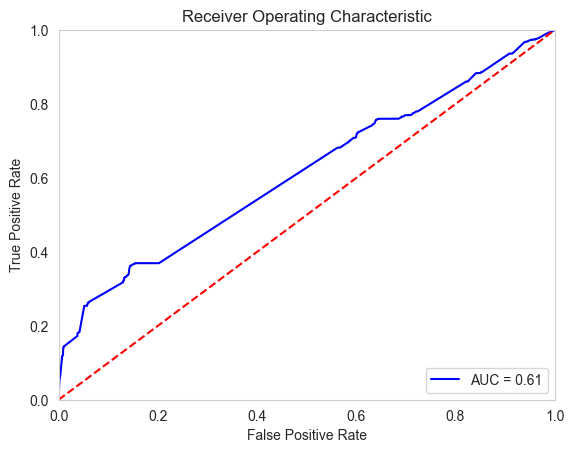

In [139]:

display(f"accuracy {(torch.round(best_predicted_temp) == y_test_tensor).float().mean().data}")
roc_graph(y_test, best_predicted_temp.detach().numpy())

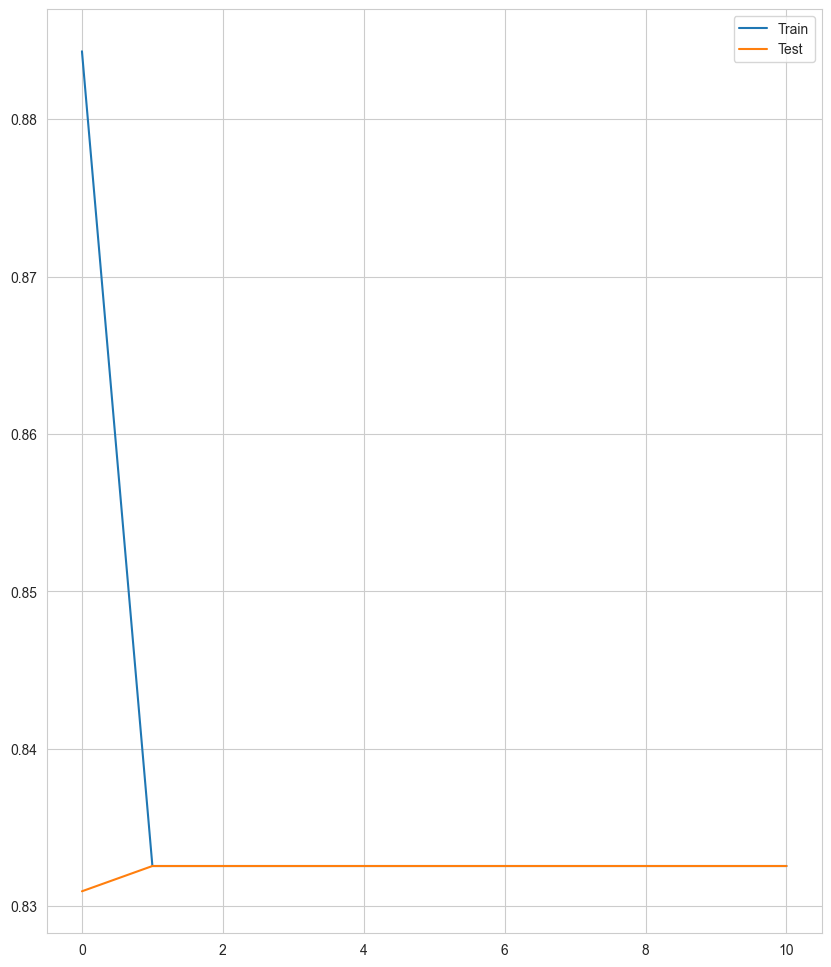

In [140]:
# построим график
show_results(train_lost, test_lost)

Вывод: Обучив 4 различные ML модели имеем следующий результат:
- LogisticRegression: Средняя оценка roc_auc лучшей модели: 0.72, Параметры: {'logisticregression__max_iter': 350, 'logisticregression__solver': 'newton-cholesky'}, оценка accuracy = 0.639.
- RandomForestClassifier: Средняя оценка roc_auc лучшей модели: 0.72, Глубина дерева: 6, Лучший критерий: entropy, оценка accuracy = 0.638.
- CatBoost: Средняя оценка roc_auc лучшей модели: 0.72 спустя 1000 итераций, оценка accuracy = 0.639.
- CustomNeuralNet: Средняя оценка roc_auc лучшей lr модели: 0.61,Модель: Линейная, полносвязная. Параметры: {'neurons': [43, 27, 17, 8, 1], 'layers': [ReLU, Softplus, LogicSigmoid, Sigmoid}, оценка accuracy = 0.48.

Результаты первых трех моделей очень схожи, но лучшей я считаю Catboost. В дальнейшем её можно будет дообучить на новых данных или увеличить количество итараций, а модель логистической регрессии уже не улучшить.
Модель нейросети довольно плохо показала себя в задаче классификации, возможно стоит пересмотреть набор параметров модели.
Для дальнейшего исследования возьмем результаты работы модели Catboost.

In [141]:
pd.DataFrame(results).drop(index='support').round(decimals=3).transpose()

,precision,recall,f1-score
Dummy Classifier (most frequent),0.270,0.520,0.356
Logistic Regression,0.682,0.639,0.623
Decision Tree Classifier,0.703,0.637,0.612
Cat Boost Classifier,0.687,0.640,0.622
Neural Net Classification,0.230,0.480,0.311


### Ислледование предсказаний лучшей модели

In [150]:
X_test['best_model_predicted_valid'] = np.round(cbc_1_preds)

Проведём графический анализ «Матрица ошибок». Выведем полноту и точность на график.

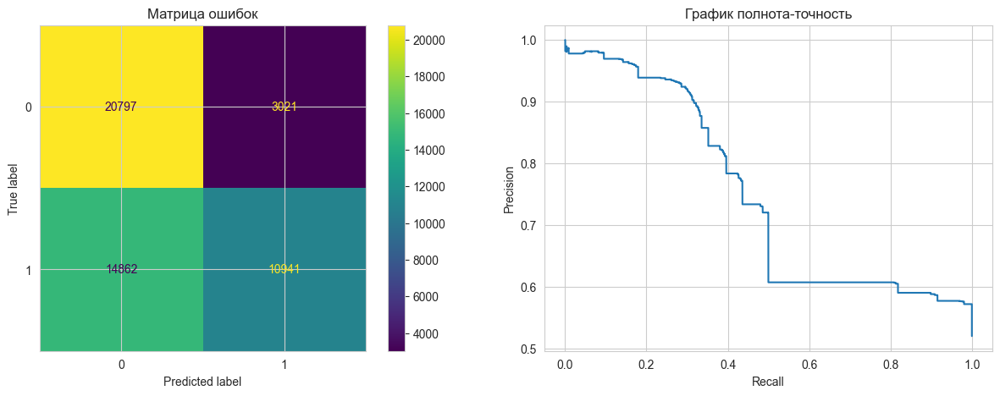

In [147]:
cm = confusion_matrix(y_test, np.round(cbc_1_preds), labels=cbc_1.classes_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
cmd = ConfusionMatrixDisplay(cm, display_labels=cbc_1.classes_)
cmd.plot(ax=ax1)
ax1.set_title('Матрица ошибок')
prec, recall, _ = precision_recall_curve(y_test, cbc_1_preds)
PrecisionRecallDisplay(prec, recall).plot(ax=ax2)
ax2.set_title('График полнота-точность')
plt.show()

In [ ]:
predicted = X_test[X_test['best_model_predicted_valid'] > 0]

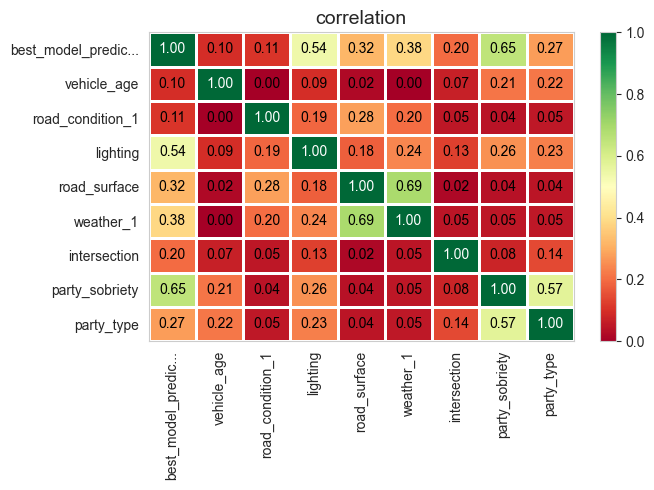

In [151]:
correlation_matrix(X_test)

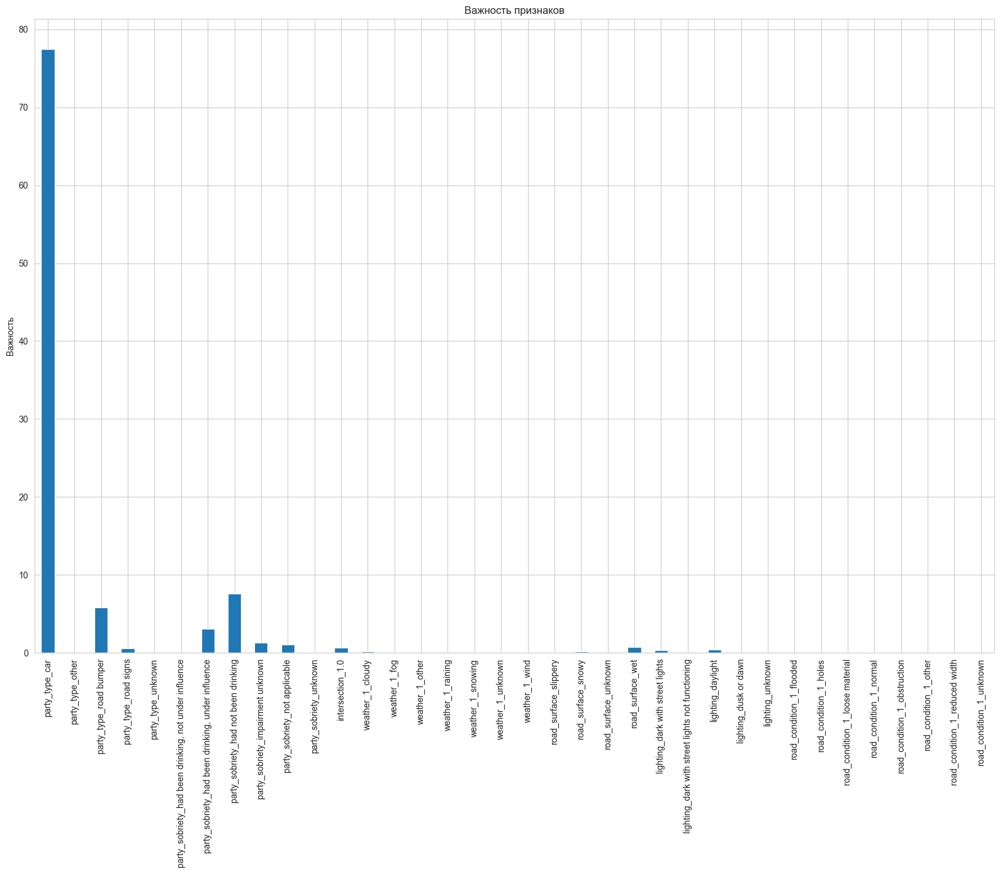

In [156]:
skl_iris_imp = pd.Series(cbc_1.get_feature_importance(),
                         X_test_scaled.columns)

fig, ax = plt.subplots(figsize=(16,14))
skl_iris_imp.plot.bar(ax=ax)
ax.set_title("Важность признаков")
ax.set_ylabel('Важность')
fig.tight_layout()

И так. По показаниям финальной модели было выявлено, что тремя основыми факторами, влияющими на вероятность ДТП являются:
- Трезвость водителя (в целом) (party_soberty)
- Освещение проезжей части (в целом) (lighting)
- Влажное ли дорожное покрытие (road_surface_wet)

Проведем дополнительное исследование влияния трезвости водителя на вероятность ДТП

In [157]:
fig = px.histogram(
    model_query, x='party_sobriety', color='at_fault',
    barmode='group',
    title='Зависимость виновности в ДТП от трезвости водителя',
    histfunc='count'
)
fig.show()

На графике видно, что именно в состянии опъянения вероятность виновности водителя возрастает.

Также по задания было необходимо исследовать зависимости виновности в аварии из-за возраста автомобиля:

In [158]:
fig = px.histogram(
    model_query, x='vehicle_age', color='at_fault',
    barmode='group',
    title='Зависимость виновности в ДТП от возраста автомобиля',
    histfunc='count'
)
fig.show()

Как ни странно, но чаще всего в ДТП виновны авто от 3х до 5ти лет!

## Общий вывод по проекту

Целью данного проекта было: создать систему, которая могла бы оценить риск ДТП по выбранному маршруту движения. Под риском понимается вероятность ДТП с любым повреждением транспортного средства. Как только водитель забронировал автомобиль, сел за руль и выбрал маршрут, система должна оценить уровень риска. Если уровень риска высок, водитель увидит предупреждение и рекомендации по маршруту.

В ходе проекта были получены и проанализированны данные о ДТП за 2012 год.
С помощью полученной информации для системы были выбраны следующие параметры данных:
    'party_type' - тип участника ДТП
    'party_sobriety' - трезвость участника ДТП
    'intersection' - признак перекрестка
    'weather_1' - погодные условия
    'road_surface' - состояние дорожного покрытия
    'lighting' - освещение дороги
    'location_type' - локация происшествия
    'road_condition_1' - состояние дорожного полотна или работы по нему
    'vehicle_age' - возраст автомобиля
    'at_fault' - признак виновности участника ДТП

Для исследования были взяты 4 типа моделей машинного обучения:
  - Логистическая регрессия
  - Дерево решений
  - Регрессионная модель Catboost
  - Линейная модель нейронной сети
Для их сравнения были выбраны следующие критерии оценки:
  - Первичные: ROC_AUC и accuracy
  т.к. мы предсказываем вероятность аварии - довольно критичного события, поэтому важна точность.
  однако происходит это редко, поэтому необходим критерий полноты ответов (0 и 1).
  - Вторичные: recall и f1_score
  для оценки истинно положительных результатов и средней точности.
По итогу самой адекватной оказалась модель Catboost со следующими результатами:
    - ROC_AUC: 0.72, accuracy: 0.64
    - precision: 0.687, recall: 0.64, f1_score: 0.62
Самыми значимыми в оценке риска ДТП оказались следующие параметры:
    - Трезвость водителя (party_soberty)
    - Освещение проезжей части (lighting)
    - Влажность дорожного покрытия (road_surface_wet)

По итогу можно сделать следующий вывод: Явно можно создать модель для оценки водительского риска ДТП, зная маршрут наперёд.
Для этого можно использовать прогноз погоды для определения погодных условий на дороге, а также информацию об освещенности отдельных участков дороги.
Но самым главным будет - определение трезвости водителя перед поездкой. Самым очевидным решением будет делать селфи-фото перед поездкой для автоматического определения состояния сонливости или опьянения, а также идентификации водителя. Либо оборудовать авто анализатором алкоголя в воздухе салона автомобиля и предупреждать водителя или каршеринговую компанию.